## Assignment- Advanced Regression


A US-based housing company named Surprise Housing has decided to enter the Australian market. The company uses data analytics to purchase houses at a price below their actual value and flip them at a higher price. For the same purpose, the company has collected a data set from house sales in Australia. The data is provided in the csv file below.

 

The company is looking at prospective properties to buy to enter the market.

You are required to build a regression model using regularization, so as to predict the actual value of the prospective properties and decide whether to invest in them or not.

 

The company wants to know:

Which variables are significant in predicting the price of a house

How well those variables describe the price of a house


## 1. Data Understanding and Exploration

Let's first have a look at the dataset and understand the size, attribute names etc.

In [15]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import linear_model
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.model_selection import GridSearchCV
from sklearn import metrics
from pandas_profiling import ProfileReport

import os

pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None) 

# hide warnings
import warnings
warnings.filterwarnings('ignore')

In [2]:
house = pd.read_csv("train.csv")
test = pd.read_csv("test.csv")

In [3]:
house.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [8]:
house.shape

(1460, 81)

In [951]:
test.shape

(1459, 80)

In [11]:
house.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

In [12]:
house.describe()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,...,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1460.000000,1460.000000,1201.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1452.000000,1460.000000,...,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,730.500000,56.897260,70.049958,10516.828082,6.099315,5.575342,1971.267808,1984.865753,103.685262,443.639726,...,94.244521,46.660274,21.954110,3.409589,15.060959,2.758904,43.489041,6.321918,2007.815753,180921.195890
std,421.610009,42.300571,24.284752,9981.264932,1.382997,1.112799,30.202904,20.645407,181.066207,456.098091,...,125.338794,66.256028,61.119149,29.317331,55.757415,40.177307,496.123024,2.703626,1.328095,79442.502883
min,1.000000,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,365.750000,20.000000,59.000000,7553.500000,5.000000,5.000000,1954.000000,1967.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,129975.000000
50%,730.500000,50.000000,69.000000,9478.500000,6.000000,5.000000,1973.000000,1994.000000,0.000000,383.500000,...,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,163000.000000
75%,1095.250000,70.000000,80.000000,11601.500000,7.000000,6.000000,2000.000000,2004.000000,166.000000,712.250000,...,168.000000,68.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,214000.000000
max,1460.000000,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,...,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


In [16]:
house.isnull().sum()

Id                 0
MSSubClass         0
MSZoning           0
LotFrontage      259
LotArea            0
                ... 
MoSold             0
YrSold             0
SaleType           0
SaleCondition      0
SalePrice          0
Length: 81, dtype: int64

In [17]:
house.nunique()

Id               1460
MSSubClass         15
MSZoning            5
LotFrontage       110
LotArea          1073
                 ... 
MoSold             12
YrSold              5
SaleType            9
SaleCondition       6
SalePrice         663
Length: 81, dtype: int64

## Categorical Variables
1. MSZoning
2. Street
3. <font color=red> Alley: 93.8% of data has Missing Values, can be removed</font>
4. LotShape
5. LandContour
6. Utilities
7. LotConfig
8. LandSlope
9. Neighborhood
10. Condition1
11. Condition2
12. BldgType
13. HouseStyle
14. RoofStyle
15. RoofMatl
16. Exterior1st
17. Exterior2nd
18. MasVnrType
19. ExterQual
20. ExterCond
21. Foundation
22. BsmtQual
23. BsmtCond
24. BsmtExposure
25. BsmtFinType1
26. BsmtFinType2
27. Heating
28. HeatingQC
29. Electrical
30. BsmtFullBath
31. BsmtHalfBath
32. FullBath
33. HalfBath
34. KitchenAbvGr
35. KitchenQual
36. Functional
37. Fireplaces
38. FireplaceQu
39. GarageType
40. GarageFinish
41. GarageCars
42. GarageQual
43. GarageCond
44. PavedDrive
45. <font color=red> PoolQC: 99.5% of data has Missing Values, can be removed</font>
46. <font color=red> Fence: 80.8% of data has Missing Values, can be removed</font>
47. <font color=red> MiscFeature: 96.3% of data has Missing Values, can be removed</font>
48. YrSold
49. SaleType
50. SaleCondition


## Numerical Variables
1. <font color=red>Id : Unique Identifier, Can be removed</font>
2. <font color=red> MSSubClass: Categorical Variable, need to be updated </font>
3. LotFrontage
4. LotArea
5. OverallQual
6. OverallCond
7. YearBuilt
8. YearRemodAdd
9. MasVnrArea
10. BsmtFinSF1
11. <font color=red>BsmtFinSF2: 88.6% of data is zero, can be removed</font>
12. BsmtUnfSF
13. TotalBsmtSF
14. 1stFlrSF
15. 2ndFlrSF
16. <font color=red>LowQualFinSF: 98.2% of data is zero, can be removed</font>
17. GrLivArea
18. BedroomAbvGr
19. TotRmsAbvGrd
20. GarageYrBlt
21. GarageArea
22. WoodDeckSF
23. OpenPorchSF
24. <font color=red>EnclosedPorch: 85.8% of data is zero, can be removed</font>
25. <font color=red>3SsnPorch: 98.4% of data is zero, can be removed</font>
26. <font color=red>ScreenPorch: 92.1% of data is zero, can be removed</font>
27. <font color=red>PoolArea: 99.5% of data is zero, can be removed</font>
28. <font color=red>MiscVal: 96.4% of data is zero, can be removed</font>
29. MoSold
30. SalePrice - Target Variable / Response Variable

## 2. Understanding Data in Numerical Columns

In [34]:
house_num = house[["MSSubClass", "LotFrontage", "LotArea", "OverallQual", "OverallCond", "YearBuilt", "YearRemodAdd","MasVnrArea","BsmtFinSF1","BsmtUnfSF","TotalBsmtSF","1stFlrSF","2ndFlrSF","GrLivArea","BedroomAbvGr","TotRmsAbvGrd","GarageYrBlt","GarageArea","WoodDeckSF","OpenPorchSF","MoSold","SalePrice"]]

In [35]:
profile = ProfileReport(house_num, title="Pandas Profiling Report")

In [36]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# 3. Data Cleaning

### <font color=red>  3.1 Drop the columns that are not needed for the analysis </font>

In [20]:
house_df = house

In [21]:
house_df.shape

(1460, 81)

In [22]:
house = house.drop(['Alley','PoolQC','Fence','MiscFeature','Id','BsmtFinSF2', 'LowQualFinSF', 'EnclosedPorch', '3SsnPorch','ScreenPorch', 'PoolArea','MiscVal' ], axis=1)

In [23]:
house.shape

(1460, 69)

###  <font color=red> 3.2 Cleaning Numerical Variables </font>

#### <font color="red"> MSSubClass is a Categorical Variable and need to be changed </font>

In [705]:
MSSubClass_details = pd.get_dummies(house['MSSubClass'], drop_first = True)

In [706]:
MSSubClass_details.head()

,30,40,45,50,60,70,75,80,85,90,120,160,180,190
0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,1,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,1,0,0,0,0,0,0,0,0
4,0,0,0,0,1,0,0,0,0,0,0,0,0,0


In [707]:
MSSubClass_details.columns = ["MSSub_30", "MSSub_40", "MSSub_45", "MSSub_50", "MSSub_60", "MSSub_70", "MSSub_75", "MSSub_80", "MSSub_85", "MSSub_90", "MSSub_120", "MSSub_160", "MSSub_180", "MSSub_190"]

In [708]:
MSSubClass_details.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1355 entries, 0 to 1458
Data columns (total 14 columns):
 #   Column     Non-Null Count  Dtype
---  ------     --------------  -----
 0   MSSub_30   1355 non-null   uint8
 1   MSSub_40   1355 non-null   uint8
 2   MSSub_45   1355 non-null   uint8
 3   MSSub_50   1355 non-null   uint8
 4   MSSub_60   1355 non-null   uint8
 5   MSSub_70   1355 non-null   uint8
 6   MSSub_75   1355 non-null   uint8
 7   MSSub_80   1355 non-null   uint8
 8   MSSub_85   1355 non-null   uint8
 9   MSSub_90   1355 non-null   uint8
 10  MSSub_120  1355 non-null   uint8
 11  MSSub_160  1355 non-null   uint8
 12  MSSub_180  1355 non-null   uint8
 13  MSSub_190  1355 non-null   uint8
dtypes: uint8(14)
memory usage: 61.4 KB


In [46]:
house1 = house

In [709]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,GarageYrBlt,GarageArea,WoodDeckSF,OpenPorchSF,SalePrice,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,KitchenQual_2fmCon,KitchenQual_Duplex,KitchenQual_Twnhs,Fireplaces_1,Fireplaces_2,Fireplaces_3,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageFinish_RFn,GarageFinish_Unf,GarageCars_1,GarageCars_2,GarageCars_3,GarageCars_4,YrSold_2007,YrSold_2008,YrSold_2009,YrSold_2010,MSSubClass
0,65.0,8450,20,20,196.0,706,150,856,856,854,1710,1,0,2,1,1,20.0,548,0,61,208500,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,1,0,0,60
1,80.0,9600,47,47,0.0,978,284,1262,1262,0,1262,0,1,2,0,1,47.0,460,298,0,181500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,0,0,0,0,1,0,0,1,0,0,1,0,0,0,20
2,68.0,11250,22,21,162.0,486,434,920,920,866,1786,1,0,2,1,1,22.0,608,0,42,223500,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0,0,1,0,0,1,0,

In [710]:
house = pd.concat([house, MSSubClass_details], axis = 1)

In [711]:
house = house.drop(columns=["MSSubClass"])

In [712]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,GarageYrBlt,GarageArea,WoodDeckSF,OpenPorchSF,SalePrice,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,KitchenQual_2fmCon,KitchenQual_Duplex,KitchenQual_Twnhs,Fireplaces_1,Fireplaces_2,Fireplaces_3,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageFinish_RFn,GarageFinish_Unf,GarageCars_1,GarageCars_2,GarageCars_3,GarageCars_4,YrSold_2007,YrSold_2008,YrSold_2009,YrSold_2010,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190
0,65.0,8450,20,20,196.0,706,150,856,856,854,1710,1,0,2,1,1,20.0,548,0,61,208500,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
1,80.0,9600,47,47,0.0,978,284,1262,1262,0,1262,0,1,2,0,1,47.0,460,298,0,181500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,68.0,11250,22,21,162.0,486,434,920,920,866,1786,1,0,2,1,1,22.0,608,0,42,223500,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1

#### <font color="red"> LotFrontage, Fix Misssing Values by Median Value 69 and Remove Out Liers greater than 144 </font>

In [68]:
house2 = house

In [81]:
house.LotFrontage.info()

<class 'pandas.core.series.Series'>
RangeIndex: 1460 entries, 0 to 1459
Series name: LotFrontage
Non-Null Count  Dtype  
--------------  -----  
1460 non-null   float64
dtypes: float64(1)
memory usage: 11.5 KB


In [82]:
house.LotFrontage = house.LotFrontage.apply(lambda x:  69 if pd.isnull(x) else x)

In [83]:
house.LotFrontage.value_counts()

69.0     270
60.0     143
70.0      70
80.0      69
50.0      57
        ... 
137.0      1
141.0      1
38.0       1
140.0      1
46.0       1
Name: LotFrontage, Length: 110, dtype: int64

##### Remove Outliers

In [84]:
house = house[(house["LotFrontage"] < 144)]

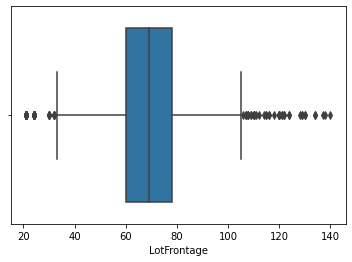

In [218]:
sns.boxplot(x=house["LotFrontage"], data=pd.melt(house))
plt.show()

In [86]:
house.shape

(1448, 96)

#### <font color="red"> LotArea, remove the out liers greater than 98th percentile </font>

In [87]:
house3 = house

In [88]:
house["LotArea"].quantile(.98)

24125.519999999968

In [90]:
house[house["LotArea"] < 24125]

,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,MoSold,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190
0,RL,65.0,8450,Pave,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,2,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
1,RL,80.0,9600,Pave,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,5,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,RL,68.0,11250,Pave,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,9,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
3,RL,60.0,9550,Pave,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,540,756,GasA,Gd,Y,SBrkr,961,756,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,2,2006,WD,Abnorml,140000,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
4,RL,84.0,14260,Pave,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,490,1145,GasA,Ex,Y,SBrkr,1145,1053,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,12,2008,WD,Normal,250000,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,RL,62.0,7917,Pave,Reg,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1999,2000,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,Unf,0,Unf,953,953,GasA,Ex,Y,SBrkr,953,694,1647,0,0,2,1,3,1,TA,7,Typ,1,TA,Attchd,1999.0,RFn,2,460,TA,TA,Y,0,40,8,2007,WD,Normal,175000,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
1456,RL,85.0,13175,Pave,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,6,1978,1988,Gable,CompShg,Plywood,Plywood,Stone,119.0,TA,TA,CBlock,Gd,TA,No,ALQ,790,Rec,589,1542,GasA,TA,Y,SBrkr,2073,0,2073,1,0,2,0,3,1,TA,7,Min1,2,TA,Attchd,1978.0,Unf,2,500,TA,TA,Y,349,0,2,2010,WD,Normal,210000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1457,RL,66.0,9042,Pave,Reg,Lvl,AllPub,Inside,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,9,1941,2006,Gable,CompShg,CemntBd,CmentBd,None,0.0,Ex,Gd,Stone,TA,Gd,No,GLQ,275,Unf,877,1152,GasA,Ex,Y,SBrkr,1

In [91]:
house = house[(house["LotArea"] < 24125)]

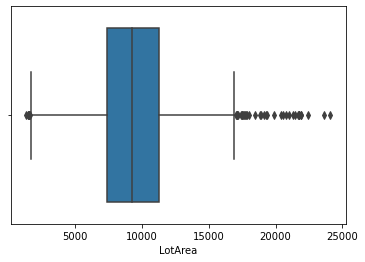

In [217]:
sns.boxplot(x=house["LotArea"], data=pd.melt(house))
plt.show()

#### <font color="red"> OverallQual, is a Categorical Variable and need to be changed</font>

In [93]:
house4 = house

In [95]:
###OverAllQual 
OverallQual_details = pd.get_dummies(house['OverallQual'], drop_first = True)

In [96]:
OverallQual_details.head()

,2,3,4,5,6,7,8,9,10
0,0,0,0,0,0,1,0,0,0
1,0,0,0,0,1,0,0,0,0
2,0,0,0,0,0,1,0,0,0
3,0,0,0,0,0,1,0,0,0
4,0,0,0,0,0,0,1,0,0


In [97]:
OverallQual_details.columns = ["Overall_Q2", "Overall_Q3", "Overall_Q4", "Overall_Q5", "Overall_Q6", "Overall_Q7", "Overall_Q8", "Overall_Q9", "Overall_Q10"]

In [98]:
OverallQual_details.head()

,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10
0,0,0,0,0,0,1,0,0,0
1,0,0,0,0,1,0,0,0,0
2,0,0,0,0,0,1,0,0,0
3,0,0,0,0,0,1,0,0,0
4,0,0,0,0,0,0,1,0,0


In [99]:
house = pd.concat([house, OverallQual_details], axis = 1)

In [100]:
house = house.drop(columns=["OverallQual"])

In [101]:
house.head()

,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,MoSold,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10
0,RL,65.0,8450,Pave,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,2,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
1,RL,80.0,9600,Pave,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,5,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
2,RL,68.0,11250,Pave,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,9,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
3,RL,60.0,9550,Pave,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,540,756,GasA,Gd,Y,SBrkr,961,756,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,2,2006,WD,Abnorml,140000,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
4,RL,84.0,14260,Pave,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,490,1145,GasA,Ex,Y,SBrkr,1145,1053,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,12,2008,WD,Normal,250000,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0


In [102]:
house.shape

(1419, 104)

#### <font color="red"> OverallCond, is a Categorical Variable and need to be changed</font>

In [103]:
house5 = house

In [104]:
###OverAllCond
OverallCond_details = pd.get_dummies(house['OverallCond'], drop_first = True)

In [105]:
OverallCond_details.head()

,2,3,4,5,6,7,8,9
0,0,0,0,1,0,0,0,0
1,0,0,0,0,0,0,1,0
2,0,0,0,1,0,0,0,0
3,0,0,0,1,0,0,0,0
4,0,0,0,1,0,0,0,0


In [106]:
OverallCond_details.columns = ["Overall_Cond2", "Overall_Cond3", "Overall_Cond4", "Overall_Cond5", "Overall_Cond6", "Overall_Cond7", "Overall_Cond8", "Overall_Cond9"]

In [107]:
OverallCond_details.head()

,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9
0,0,0,0,1,0,0,0,0
1,0,0,0,0,0,0,1,0
2,0,0,0,1,0,0,0,0
3,0,0,0,1,0,0,0,0
4,0,0,0,1,0,0,0,0


In [108]:
house = pd.concat([house, OverallCond_details], axis = 1)

In [109]:
house = house.drop(columns=["OverallCond"])

In [110]:
house.head()

,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,MoSold,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9
0,RL,65.0,8450,Pave,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,2,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0
1,RL,80.0,9600,Pave,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,5,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0
2,RL,68.0,11250,Pave,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,9,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0
3,RL,60.0,9550,Pave,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,540,756,GasA,Gd,Y,SBrkr,961,756,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,2,2006,WD,Abnorml,140000,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0
4,RL,84.0,14260,Pave,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,490,1145,GasA,Ex,Y,SBrkr,1145,1053,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,12,2008,WD,Normal,250000,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0


In [111]:
house.shape

(1419, 111)

#### <font color="red"> YearBuilt: Subtract the year from current year to have a column of numerical values</font>

In [112]:
house6 = house

In [116]:
house.YearBuilt = house.YearBuilt.apply(lambda x: 2023-x)

In [117]:
house.YearBuilt 

0        20
1        47
2        22
3       108
4        23
       ... 
1455     24
1456     45
1457     82
1458     73
1459     58
Name: YearBuilt, Length: 1419, dtype: int64

In [118]:
house.YearBuilt.info()

<class 'pandas.core.series.Series'>
Int64Index: 1419 entries, 0 to 1459
Series name: YearBuilt
Non-Null Count  Dtype
--------------  -----
1419 non-null   int64
dtypes: int64(1)
memory usage: 22.2 KB


#### <font color="red"> YearRemodAdd: Subtract the year from current year to have a column of numerical values</font>

In [119]:
house7 = house

In [121]:
house.YearRemodAdd.info()

<class 'pandas.core.series.Series'>
Int64Index: 1419 entries, 0 to 1459
Series name: YearRemodAdd
Non-Null Count  Dtype
--------------  -----
1419 non-null   int64
dtypes: int64(1)
memory usage: 22.2 KB


In [122]:
house.YearRemodAdd = house.YearRemodAdd.apply(lambda x: 2023-x)

In [123]:
house.YearRemodAdd

0       20
1       47
2       21
3       53
4       23
        ..
1455    23
1456    35
1457    17
1458    27
1459    58
Name: YearRemodAdd, Length: 1419, dtype: int64

#### <font color="red"> MasVnrArea: Remove the Out Liers greater than 921 and fix the missing values with the mean 103 </font>

In [124]:
house8 = house

In [125]:
house.MasVnrArea.info()

<class 'pandas.core.series.Series'>
Int64Index: 1419 entries, 0 to 1459
Series name: MasVnrArea
Non-Null Count  Dtype  
--------------  -----  
1412 non-null   float64
dtypes: float64(1)
memory usage: 22.2 KB


In [128]:
### MasVnrArea Remove Out Liers
house = house[house["MasVnrArea"] < 921]

In [129]:
house.MasVnrArea = house.MasVnrArea.apply(lambda x: 103 if pd.isnull(x) else x)

In [131]:
house.MasVnrArea.info()

<class 'pandas.core.series.Series'>
Int64Index: 1403 entries, 0 to 1459
Series name: MasVnrArea
Non-Null Count  Dtype  
--------------  -----  
1403 non-null   float64
dtypes: float64(1)
memory usage: 21.9 KB


#### <font color="red"> BsmtFinSF1: Remove the Out Liers greater than 1696  </font>

In [132]:
house9 = house

In [133]:
house.BsmtFinSF1.info()

<class 'pandas.core.series.Series'>
Int64Index: 1403 entries, 0 to 1459
Series name: BsmtFinSF1
Non-Null Count  Dtype
--------------  -----
1403 non-null   int64
dtypes: int64(1)
memory usage: 21.9 KB


In [135]:
### BsmtFinSF1 - Remove outliers 
house = house[house["BsmtFinSF1"] < 1696]

In [136]:
house.MasVnrArea.info()

<class 'pandas.core.series.Series'>
Int64Index: 1398 entries, 0 to 1459
Series name: MasVnrArea
Non-Null Count  Dtype  
--------------  -----  
1398 non-null   float64
dtypes: float64(1)
memory usage: 21.8 KB


#### <font color="red"> BsmtUnfSF: Remove the Out Liers greater than 1907  </font>

In [137]:
house10 = house

In [138]:
house.BsmtUnfSF.info()

<class 'pandas.core.series.Series'>
Int64Index: 1398 entries, 0 to 1459
Series name: BsmtUnfSF
Non-Null Count  Dtype
--------------  -----
1398 non-null   int64
dtypes: int64(1)
memory usage: 21.8 KB


In [140]:
### BsmtUnfSF - Remove outliers greater than 1907
house = house[house["BsmtUnfSF"] < 1907]

In [141]:
house.MasVnrArea.info()

<class 'pandas.core.series.Series'>
Int64Index: 1389 entries, 0 to 1459
Series name: MasVnrArea
Non-Null Count  Dtype  
--------------  -----  
1389 non-null   float64
dtypes: float64(1)
memory usage: 21.7 KB


#### <font color="red"> TotalBsmtSF: Remove the Out Liers greater than 2392  </font>

In [142]:
house11 = house

In [143]:
house.TotalBsmtSF.info()

<class 'pandas.core.series.Series'>
Int64Index: 1389 entries, 0 to 1459
Series name: TotalBsmtSF
Non-Null Count  Dtype
--------------  -----
1389 non-null   int64
dtypes: int64(1)
memory usage: 21.7 KB


In [145]:
### TotalBsmtSF - Remove outliers greater than 2392
house = house[house["TotalBsmtSF"] < 2392]

In [146]:
house.MasVnrArea.info()

<class 'pandas.core.series.Series'>
Int64Index: 1386 entries, 0 to 1459
Series name: MasVnrArea
Non-Null Count  Dtype  
--------------  -----  
1386 non-null   float64
dtypes: float64(1)
memory usage: 21.7 KB


#### <font color="red"> 1stFlrSF: Remove the Out Liers greater than 2402  </font>

In [147]:
house12 = house

In [153]:
house["1stFlrSF"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1386 entries, 0 to 1459
Series name: 1stFlrSF
Non-Null Count  Dtype
--------------  -----
1386 non-null   int64
dtypes: int64(1)
memory usage: 21.7 KB


In [154]:
### 1stFlrSF - Remove outliers greater than 2402
house = house[house["1stFlrSF"] < 2402]

In [155]:
house["1stFlrSF"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1385 entries, 0 to 1459
Series name: 1stFlrSF
Non-Null Count  Dtype
--------------  -----
1385 non-null   int64
dtypes: int64(1)
memory usage: 21.6 KB


#### <font color="red"> 2ndFlrSF: Remove the Out Liers greater than 1519  </font>

In [156]:
house13 = house

In [157]:
house["2ndFlrSF"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1385 entries, 0 to 1459
Series name: 2ndFlrSF
Non-Null Count  Dtype
--------------  -----
1385 non-null   int64
dtypes: int64(1)
memory usage: 21.6 KB


In [158]:
### 2ndFlrSF - Remove outliers greater than 1519
house = house[house["2ndFlrSF"] < 1519]

In [159]:
house["2ndFlrSF"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1381 entries, 0 to 1459
Series name: 2ndFlrSF
Non-Null Count  Dtype
--------------  -----
1381 non-null   int64
dtypes: int64(1)
memory usage: 21.6 KB


#### <font color="red"> GrLivArea: Remove the Out Liers greater than 3279  </font>

In [160]:
house14 = house

In [161]:
house["GrLivArea"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1381 entries, 0 to 1459
Series name: GrLivArea
Non-Null Count  Dtype
--------------  -----
1381 non-null   int64
dtypes: int64(1)
memory usage: 21.6 KB


In [162]:
### GrLivArea - Remove outliers greater than 3279
house = house[house["GrLivArea"] < 3279]

In [163]:
house["GrLivArea"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1378 entries, 0 to 1459
Series name: GrLivArea
Non-Null Count  Dtype
--------------  -----
1378 non-null   int64
dtypes: int64(1)
memory usage: 21.5 KB


#### <font color="red"> BedroomAbvGr: Categorical Variable, need to change it  </font>

In [164]:
house15 = house

In [165]:
house["BedroomAbvGr"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1378 entries, 0 to 1459
Series name: BedroomAbvGr
Non-Null Count  Dtype
--------------  -----
1378 non-null   int64
dtypes: int64(1)
memory usage: 21.5 KB


In [166]:
###OverAllCond
BedroomAbvGr_details = pd.get_dummies(house['BedroomAbvGr'], drop_first = True)

In [167]:
BedroomAbvGr_details.head()

,1,2,3,4,5,6
0,0,0,1,0,0,0
1,0,0,1,0,0,0
2,0,0,1,0,0,0
3,0,0,1,0,0,0
4,0,0,0,1,0,0


In [168]:
BedroomAbvGr_details.columns = ["BedroomAbvGr_1", "BedroomAbvGr_2", "BedroomAbvGr_3", "BedroomAbvGr_4", "BedroomAbvGr_5", "BedroomAbvGr_6"]

In [169]:
BedroomAbvGr_details.head()

,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6
0,0,0,1,0,0,0
1,0,0,1,0,0,0
2,0,0,1,0,0,0
3,0,0,1,0,0,0
4,0,0,0,1,0,0


In [170]:
house = pd.concat([house, BedroomAbvGr_details], axis = 1)

In [171]:
house = house.drop(columns=["BedroomAbvGr"])

In [172]:
house.head()

,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,MoSold,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6
0,RL,65.0,8450,Pave,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,20,20,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,2,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0
1,RL,80.0,9600,Pave,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,47,47,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,5,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0
2,RL,68.0,11250,Pave,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,22,21,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,9,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0
3,RL,60.0,9550,Pave,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,108,53,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,540,756,GasA,Gd,Y,SBrkr,961,756,1717,1,0,1,0,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,2,2006,WD,Abnorml,140000,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0
4,RL,84.0,14260,Pave,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,23,23,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,490,1145,GasA,Ex,Y,SBrkr,1145,1053,2198,1,0,2,1,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,12,2008,WD,Normal,250000,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0


In [173]:
house.shape

(1378, 116)

#### <font color="red"> TotRmsAbvGrd: Categorical Variable, need to change it  </font>

In [174]:
house16 = house

In [176]:
house["TotRmsAbvGrd"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1378 entries, 0 to 1459
Series name: TotRmsAbvGrd
Non-Null Count  Dtype
--------------  -----
1378 non-null   int64
dtypes: int64(1)
memory usage: 21.5 KB


In [177]:
###OverAllCond
TotRmsAbvGrd_details = pd.get_dummies(house['TotRmsAbvGrd'], drop_first = True)

In [178]:
TotRmsAbvGrd_details.head()

,3,4,5,6,7,8,9,10,11,12
0,0,0,0,0,0,1,0,0,0,0
1,0,0,0,1,0,0,0,0,0,0
2,0,0,0,1,0,0,0,0,0,0
3,0,0,0,0,1,0,0,0,0,0
4,0,0,0,0,0,0,1,0,0,0


In [179]:
TotRmsAbvGrd_details.columns = ["TotRmsAbvGrd_3", "TotRmsAbvGrd_4", "TotRmsAbvGrd_5", "TotRmsAbvGrd_6", "TotRmsAbvGrd_7", "TotRmsAbvGrd_8", "TotRmsAbvGrd_9", "TotRmsAbvGrd_10", "TotRmsAbvGrd_11", "TotRmsAbvGrd_12"]

In [180]:
TotRmsAbvGrd_details.head()

,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12
0,0,0,0,0,0,1,0,0,0,0
1,0,0,0,1,0,0,0,0,0,0
2,0,0,0,1,0,0,0,0,0,0
3,0,0,0,0,1,0,0,0,0,0
4,0,0,0,0,0,0,1,0,0,0


In [181]:
house = pd.concat([house, TotRmsAbvGrd_details], axis = 1)

In [182]:
house = house.drop(columns=["TotRmsAbvGrd"])

In [183]:
house.head()

,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,MoSold,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12
0,RL,65.0,8450,Pave,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,20,20,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,2,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0
1,RL,80.0,9600,Pave,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,47,47,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,5,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0
2,RL,68.0,11250,Pave,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,22,21,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,9,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0
3,RL,60.0,9550,Pave,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,108,53,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,540,756,GasA,Gd,Y,SBrkr,961,756,1717,1,0,1,0,1,Gd,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,2,2006,WD,Abnorml,140000,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0
4,RL,84.0,14260,Pave,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,23,23,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,490,1145,GasA,Ex,Y,SBrkr,1145,1053,2198,1,0,2,1,1,Gd,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,12,2008,WD,Normal,250000,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0


In [184]:
house.shape

(1378, 125)

#### <font color="red"> GarageYrBlt: Subtract the year from current year to have a column of numerical values</font>

In [195]:
house18 = house

In [196]:
house.GarageYrBlt = house.GarageYrBlt.apply(lambda x: 2023-x)

In [197]:
house.GarageYrBlt 

0       20.0
1       47.0
2       22.0
3       25.0
4       23.0
        ... 
1455    24.0
1456    45.0
1457    82.0
1458    73.0
1459    58.0
Name: GarageYrBlt, Length: 1378, dtype: float64

In [599]:
house.GarageYrBlt.info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: GarageYrBlt
Non-Null Count  Dtype  
--------------  -----  
1277 non-null   float64
dtypes: float64(1)
memory usage: 21.2 KB


In [600]:
house.GarageYrBlt.value_counts()

18.0     63
17.0     52
19.0     52
20.0     45
16.0     41
         ..
105.0     1
117.0     1
96.0      1
123.0     1
90.0      1
Name: GarageYrBlt, Length: 96, dtype: int64

In [601]:
house.GarageYrBlt.describe()

count    1277.000000
mean       45.067345
std        24.723902
min        13.000000
25%        21.000000
50%        44.000000
75%        63.000000
max       123.000000
Name: GarageYrBlt, dtype: float64

In [726]:
house.GarageYrBlt = house.GarageYrBlt.fillna(45.06)

#### <font color="red"> GarageArea: Remove the Out Liers greater than 1052  </font>

In [199]:
house19 = house

In [200]:
house.GarageArea.info()

<class 'pandas.core.series.Series'>
Int64Index: 1378 entries, 0 to 1459
Series name: GarageArea
Non-Null Count  Dtype
--------------  -----
1378 non-null   int64
dtypes: int64(1)
memory usage: 21.5 KB


In [201]:
### GarageArea - Remove outliers greater than 1052
house = house[house["GarageArea"] < 1052]

In [202]:
house.GarageArea.info()

<class 'pandas.core.series.Series'>
Int64Index: 1372 entries, 0 to 1459
Series name: GarageArea
Non-Null Count  Dtype
--------------  -----
1372 non-null   int64
dtypes: int64(1)
memory usage: 21.4 KB


#### <font color="red"> WoodDeckSF: Remove the Out Liers greater than 550  </font>

In [203]:
house20 = house

In [204]:
house.WoodDeckSF.info()

<class 'pandas.core.series.Series'>
Int64Index: 1372 entries, 0 to 1459
Series name: WoodDeckSF
Non-Null Count  Dtype
--------------  -----
1372 non-null   int64
dtypes: int64(1)
memory usage: 21.4 KB


In [205]:
### WoodDeckSF - Remove outliers greater than 550
house = house[house["WoodDeckSF"] < 550]

In [206]:
house.WoodDeckSF.info()

<class 'pandas.core.series.Series'>
Int64Index: 1364 entries, 0 to 1458
Series name: WoodDeckSF
Non-Null Count  Dtype
--------------  -----
1364 non-null   int64
dtypes: int64(1)
memory usage: 21.3 KB


#### <font color="red"> OpenPorchSF: Remove the Out Liers greater than 304  </font>

In [207]:
house21 = house

In [208]:
house.OpenPorchSF.info()

<class 'pandas.core.series.Series'>
Int64Index: 1364 entries, 0 to 1458
Series name: OpenPorchSF
Non-Null Count  Dtype
--------------  -----
1364 non-null   int64
dtypes: int64(1)
memory usage: 21.3 KB


In [211]:
### OpenPorchSF - Remove outliers greater than 304
house = house[house["OpenPorchSF"] < 304]

In [212]:
house.OpenPorchSF.info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: OpenPorchSF
Non-Null Count  Dtype
--------------  -----
1355 non-null   int64
dtypes: int64(1)
memory usage: 21.2 KB


#### <font color="red"> MoSold: Categorical Variable, need to change it  </font>

In [185]:
house17 = house

In [186]:
house["MoSold"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1378 entries, 0 to 1459
Series name: MoSold
Non-Null Count  Dtype
--------------  -----
1378 non-null   int64
dtypes: int64(1)
memory usage: 21.5 KB


In [187]:
###OverAllCond
MoSold_details = pd.get_dummies(house['MoSold'], drop_first = True)

In [188]:
MoSold_details.head()

,2,3,4,5,6,7,8,9,10,11,12
0,1,0,0,0,0,0,0,0,0,0,0
1,0,0,0,1,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,1,0,0,0
3,1,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,1


In [189]:
MoSold_details.columns = ["MoSold_2", "MoSold_3", "MoSold_4", "MoSold_5", "MoSold_6", "MoSold_7", "MoSold_8", "MoSold_9", "MoSold_10", "MoSold_11", "MoSold_12"]

In [190]:
MoSold_details.head()

,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12
0,1,0,0,0,0,0,0,0,0,0,0
1,0,0,0,1,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,1,0,0,0
3,1,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,1


In [191]:
house = pd.concat([house, MoSold_details], axis = 1)

In [192]:
house = house.drop(columns=["MoSold"])

In [193]:
house.head()

,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12
0,RL,65.0,8450,Pave,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,20,20,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
1,RL,80.0,9600,Pave,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,47,47,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
2,RL,68.0,11250,Pave,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,22,21,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
3,RL,60.0,9550,Pave,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,108,53,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,540,756,GasA,Gd,Y,SBrkr,961,756,1717,1,0,1,0,1,Gd,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,2006,WD,Abnorml,140000,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
4,RL,84.0,14260,Pave,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,23,23,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,490,1145,GasA,Ex,Y,SBrkr,1145,1053,2198,1,0,2,1,1,Gd,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,2008,WD,Normal,250000,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1


In [194]:
house.shape

(1378, 135)

### <font color=red> 3.3 Cleaning Categorical Variables </font>

In [219]:
house.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1355 entries, 0 to 1458
Data columns (total 135 columns):
 #    Column           Non-Null Count  Dtype  
---   ------           --------------  -----  
 0    MSZoning         1355 non-null   object 
 1    LotFrontage      1355 non-null   float64
 2    LotArea          1355 non-null   int64  
 3    Street           1355 non-null   object 
 4    LotShape         1355 non-null   object 
 5    LandContour      1355 non-null   object 
 6    Utilities        1355 non-null   object 
 7    LotConfig        1355 non-null   object 
 8    LandSlope        1355 non-null   object 
 9    Neighborhood     1355 non-null   object 
 10   Condition1       1355 non-null   object 
 11   Condition2       1355 non-null   object 
 12   BldgType         1355 non-null   object 
 13   HouseStyle       1355 non-null   object 
 14   YearBuilt        1355 non-null   int64  
 15   YearRemodAdd     1355 non-null   int64  
 16   RoofStyle        1355 non-null   object 

#### <font color=red>  1    MSZoning         1355 non-null   object</font>

In [222]:
house22 = house

In [223]:
house["MSZoning"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: MSZoning
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [224]:
house["MSZoning"].value_counts()

RL         1064
RM          210
FV           58
RH           15
C (all)       8
Name: MSZoning, dtype: int64

In [227]:
MSZoning_details = pd.get_dummies(house['MSZoning'], drop_first = True)

In [228]:
MSZoning_details.head()

,FV,RH,RL,RM
0,0,0,1,0
1,0,0,1,0
2,0,0,1,0
3,0,0,1,0
4,0,0,1,0


In [229]:
MSZoning_details.columns = ["MSZoning_FV", "MSZoning_RH", "MSZoning_RL", "MSZoning_RM"]

In [230]:
MSZoning_details.head()

,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM
0,0,0,1,0
1,0,0,1,0
2,0,0,1,0
3,0,0,1,0
4,0,0,1,0


In [231]:
house = pd.concat([house, MSZoning_details], axis = 1)

In [232]:
house = house.drop(columns=["MSZoning"])

In [233]:
house.head()

,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM
0,65.0,8450,Pave,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,20,20,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0
1,80.0,9600,Pave,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,47,47,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0
2,68.0,11250,Pave,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,22,21,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0
3,60.0,9550,Pave,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,108,53,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,540,756,GasA,Gd,Y,SBrkr,961,756,1717,1,0,1,0,1,Gd,Typ,1,Gd,Detchd,25.0,Unf,3,642,TA,TA,Y,0,35,2006,WD,Abnorml,140000,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0
4,84.0,14260,Pave,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,23,23,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,490,1145,GasA,Ex,Y,SBrkr,1145,1053,2198,1,0,2,1,1,Gd,Typ,1,TA,Attchd,23.0,RFn,3,836,TA,TA,Y,192,84,2008,WD,Normal,250000,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0


In [234]:
house.shape

(1355, 138)

#### <font color=red>  2    Street           1355 non-null   object </font>

In [235]:
house23 = house

In [236]:
house["Street"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: Street
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [237]:
house["Street"].value_counts()

Pave    1352
Grvl       3
Name: Street, dtype: int64

In [238]:
house = house.drop(columns=['Street'])

In [239]:
house.shape

(1355, 137)

#### <font color=red>  3    LotShape         1355 non-null   object </font>

In [240]:
house24 = house

In [241]:
house["LotShape"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: LotShape
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [242]:
house["LotShape"].value_counts()

Reg    879
IR1    443
IR2     28
IR3      5
Name: LotShape, dtype: int64

In [243]:
LotShape_details = pd.get_dummies(house['LotShape'], drop_first = True)

In [244]:
LotShape_details.head()

,IR2,IR3,Reg
0,0,0,1
1,0,0,1
2,0,0,0
3,0,0,0
4,0,0,0


In [246]:
LotShape_details.columns = ["LotShape_IR2", "LotShape_IR3", "LotShape_Reg"]

In [247]:
LotShape_details.head()

,LotShape_IR2,LotShape_IR3,LotShape_Reg
0,0,0,1
1,0,0,1
2,0,0,0
3,0,0,0
4,0,0,0


In [248]:
house = pd.concat([house, LotShape_details], axis = 1)

In [249]:
house = house.drop(columns=["LotShape"])

In [250]:
house.head()

,LotFrontage,LotArea,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg
0,65.0,8450,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,20,20,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1
1,80.0,9600,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,47,47,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1
2,68.0,11250,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,22,21,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0
3,60.0,9550,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,108,53,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,540,756,GasA,Gd,Y,SBrkr,961,756,1717,1,0,1,0,1,Gd,Typ,1,Gd,Detchd,25.0,Unf,3,642,TA,TA,Y,0,35,2006,WD,Abnorml,140000,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
4,84.0,14260,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,23,23,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,490,1145,GasA,Ex,Y,SBrkr,1145,1053,2198,1,0,2,1,1,Gd,Typ,1,TA,Attchd,23.0,RFn,3,836,TA,TA,Y,192,84,2008,WD,Normal,250000,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0


In [251]:
house.shape

(1355, 139)

#### <font color=red>  4    LandContour      1355 non-null   object </font>

In [252]:
house25 = house

In [253]:
house["LandContour"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: LandContour
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [254]:
house["LandContour"].value_counts()

Lvl    1235
Bnk      55
HLS      43
Low      22
Name: LandContour, dtype: int64

In [255]:
###OverAllCond
LandContour_details = pd.get_dummies(house['LandContour'], drop_first = True)

In [257]:
LandContour_details.head()

,HLS,Low,Lvl
0,0,0,1
1,0,0,1
2,0,0,1
3,0,0,1
4,0,0,1


In [258]:
LandContour_details.columns = ["LandContour_HLS", "LandContour_Low", "LandContour_Lvl"]

In [259]:
LandContour_details.head()

,LandContour_HLS,LandContour_Low,LandContour_Lvl
0,0,0,1
1,0,0,1
2,0,0,1
3,0,0,1
4,0,0,1


In [260]:
house = pd.concat([house, LandContour_details], axis = 1)

In [261]:
house = house.drop(columns=["LandContour"])

In [262]:
house.head()

,LotFrontage,LotArea,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl
0,65.0,8450,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,20,20,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1
1,80.0,9600,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,47,47,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1
2,68.0,11250,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,22,21,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1
3,60.0,9550,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,108,53,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,540,756,GasA,Gd,Y,SBrkr,961,756,1717,1,0,1,0,1,Gd,Typ,1,Gd,Detchd,25.0,Unf,3,642,TA,TA,Y,0,35,2006,WD,Abnorml,140000,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1
4,84.0,14260,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,23,23,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,490,1145,GasA,Ex,Y,SBrkr,1145,1053,2198,1,0,2,1,1,Gd,Typ,1,TA,Attchd,23.0,RFn,3,836,TA,TA,Y,192,84,2008,WD,Normal,250000,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1


In [263]:
house.shape

(1355, 141)

#### <font color=red>   5    Utilities        1355 non-null   object </font>

In [222]:
house26 = house

In [264]:
house["Utilities"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: Utilities
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [265]:
house["Utilities"].value_counts()

AllPub    1354
NoSeWa       1
Name: Utilities, dtype: int64

In [266]:
house = house.drop(columns=["Utilities"])

In [267]:
house.shape

(1355, 140)

#### <font color=red>   6    LotConfig        1355 non-null   object </font>

In [268]:
house27 = house

In [269]:
house["LotConfig"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: LotConfig
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [270]:
house["LotConfig"].value_counts()

Inside     986
Corner     242
CulDSac     78
FR2         45
FR3          4
Name: LotConfig, dtype: int64

In [271]:
LotConfig_details = pd.get_dummies(house['LotConfig'], drop_first = True)

In [272]:
LotConfig_details.head()

,CulDSac,FR2,FR3,Inside
0,0,0,0,1
1,0,1,0,0
2,0,0,0,1
3,0,0,0,0
4,0,1,0,0


In [273]:
LotConfig_details.columns = ["LotConfig_CulDSac", "LotConfig_FR2", "LotConfig_FR3", "LotConfig_Inside"]

In [274]:
LotConfig_details.head()

,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside
0,0,0,0,1
1,0,1,0,0
2,0,0,0,1
3,0,0,0,0
4,0,1,0,0


In [275]:
house = pd.concat([house, LotConfig_details], axis = 1)

In [276]:
house = house.drop(columns=["LotConfig"])

In [277]:
house.head()

,LotFrontage,LotArea,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside
0,65.0,8450,Gtl,CollgCr,Norm,Norm,1Fam,2Story,20,20,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1
1,80.0,9600,Gtl,Veenker,Feedr,Norm,1Fam,1Story,47,47,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0
2,68.0,11250,Gtl,CollgCr,Norm,Norm,1Fam,2Story,22,21,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1
3,60.0,9550,Gtl,Crawfor,Norm,Norm,1Fam,2Story,108,53,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,540,756,GasA,Gd,Y,SBrkr,961,756,1717,1,0,1,0,1,Gd,Typ,1,Gd,Detchd,25.0,Unf,3,642,TA,TA,Y,0,35,2006,WD,Abnorml,140000,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0
4,84.0,14260,Gtl,NoRidge,Norm,Norm,1Fam,2Story,23,23,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,490,1145,GasA,Ex,Y,SBrkr,1145,1053,2198,1,0,2,1,1,Gd,Typ,1,TA,Attchd,23.0,RFn,3,836,TA,TA,Y,192,84,2008,WD,Normal,250000,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,1,0,0


In [278]:
house.shape

(1355, 143)

#### <font color=red>   7    LandSlope        1355 non-null   object </font>

In [279]:
house28 = house

In [280]:
house["LandSlope"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: LandSlope
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [281]:
house["LandSlope"].value_counts()

Gtl    1298
Mod      52
Sev       5
Name: LandSlope, dtype: int64

In [282]:
house = house.drop(columns=["LandSlope"])

In [283]:
house.head()

,LotFrontage,LotArea,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside
0,65.0,8450,CollgCr,Norm,Norm,1Fam,2Story,20,20,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1
1,80.0,9600,Veenker,Feedr,Norm,1Fam,1Story,47,47,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0
2,68.0,11250,CollgCr,Norm,Norm,1Fam,2Story,22,21,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1
3,60.0,9550,Crawfor,Norm,Norm,1Fam,2Story,108,53,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,540,756,GasA,Gd,Y,SBrkr,961,756,1717,1,0,1,0,1,Gd,Typ,1,Gd,Detchd,25.0,Unf,3,642,TA,TA,Y,0,35,2006,WD,Abnorml,140000,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0
4,84.0,14260,NoRidge,Norm,Norm,1Fam,2Story,23,23,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,490,1145,GasA,Ex,Y,SBrkr,1145,1053,2198,1,0,2,1,1,Gd,Typ,1,TA,Attchd,23.0,RFn,3,836,TA,TA,Y,192,84,2008,WD,Normal,250000,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,1,0,0


In [284]:
house.shape

(1355, 142)

#### <font color=red>   8    Neighborhood     1355 non-null   object </font>

In [285]:
house29 = house

In [286]:
house["Neighborhood"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: Neighborhood
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [287]:
house["Neighborhood"].value_counts()

NAmes      218
CollgCr    147
OldTown    107
Edwards     96
Somerst     78
Gilbert     72
Sawyer      72
NWAmes      70
NridgHt     65
BrkSide     57
SawyerW     56
Crawfor     49
Mitchel     43
IDOTRR      35
Timber      30
NoRidge     28
SWISU       23
StoneBr     21
ClearCr     18
Blmngtn     17
MeadowV     16
BrDale      16
Veenker     10
NPkVill      9
Blueste      2
Name: Neighborhood, dtype: int64

In [288]:
###OverAllCond
Neighborhood_details = pd.get_dummies(house['Neighborhood'], drop_first = True)

In [290]:
Neighborhood_details.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1355 entries, 0 to 1458
Data columns (total 24 columns):
 #   Column   Non-Null Count  Dtype
---  ------   --------------  -----
 0   Blueste  1355 non-null   uint8
 1   BrDale   1355 non-null   uint8
 2   BrkSide  1355 non-null   uint8
 3   ClearCr  1355 non-null   uint8
 4   CollgCr  1355 non-null   uint8
 5   Crawfor  1355 non-null   uint8
 6   Edwards  1355 non-null   uint8
 7   Gilbert  1355 non-null   uint8
 8   IDOTRR   1355 non-null   uint8
 9   MeadowV  1355 non-null   uint8
 10  Mitchel  1355 non-null   uint8
 11  NAmes    1355 non-null   uint8
 12  NPkVill  1355 non-null   uint8
 13  NWAmes   1355 non-null   uint8
 14  NoRidge  1355 non-null   uint8
 15  NridgHt  1355 non-null   uint8
 16  OldTown  1355 non-null   uint8
 17  SWISU    1355 non-null   uint8
 18  Sawyer   1355 non-null   uint8
 19  SawyerW  1355 non-null   uint8
 20  Somerst  1355 non-null   uint8
 21  StoneBr  1355 non-null   uint8
 22  Timber   1355 non-null  

In [291]:
Neighborhood_details.columns = ["Neighborhood_Blueste", "Neighborhood_BrDale", "Neighborhood_BrkSide", "Neighborhood_ClearCr", "Neighborhood_CollgCr", "Neighborhood_Crawfor", "Neighborhood_Edwards", "Neighborhood_Gilbert", "Neighborhood_IDOTRR",  "Neighborhood_MeadowV",  "Neighborhood_Mitchel", "Neighborhood_NAmes", "Neighborhood_NPkVill", "Neighborhood_NWAmes", "Neighborhood_NoRidge", "Neighborhood_NridgHt", "Neighborhood_OldTown", "Neighborhood_SWISU", "Neighborhood_Sawyer", "Neighborhood_SawyerW", "Neighborhood_Somerst", "Neighborhood_StoneBr", "Neighborhood_Timber", "Neighborhood_Veenker" ]

In [292]:
Neighborhood_details.head()

,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker
0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
2,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0


In [293]:
house = pd.concat([house, Neighborhood_details], axis = 1)

In [294]:
house = house.drop(columns=["Neighborhood"])

In [295]:
house.head()

,LotFrontage,LotArea,Condition1,Condition2,BldgType,HouseStyle,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker
0,65.0,8450,Norm,Norm,1Fam,2Story,20,20,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,80.0,9600,Feedr,Norm,1Fam,1Story,47,47,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
2,68.0,11250,Norm,Norm,1Fam,2Story,22,21,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,60.0,9550,Norm,Norm,1Fam,2Story,108,53,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,540,756,GasA,Gd,Y,SBrkr,961,756,1717,1,0,1,0,1,Gd,Typ,1,Gd,Detchd,25.0,Unf,3,642,TA,TA,Y,0,35,2006,WD,Abnorml,140000,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,84.0,14260,Norm,Norm,1Fam,2Story,23,23,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.

In [296]:
house.shape

(1355, 165)

#### <font color=red>   9    Condition1       1355 non-null   object </font>

In [297]:
house30 = house

In [298]:
house["Condition1"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: Condition1
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [299]:
house["Condition1"].value_counts()

Norm      1170
Feedr       76
Artery      45
RRAn        24
PosN        15
RRAe        11
PosA         7
RRNn         5
RRNe         2
Name: Condition1, dtype: int64

In [300]:
house = house.drop(columns=["Condition1"])

In [301]:
house.head()

,LotFrontage,LotArea,Condition2,BldgType,HouseStyle,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker
0,65.0,8450,Norm,1Fam,2Story,20,20,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,80.0,9600,Norm,1Fam,1Story,47,47,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
2,68.0,11250,Norm,1Fam,2Story,22,21,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,60.0,9550,Norm,1Fam,2Story,108,53,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,540,756,GasA,Gd,Y,SBrkr,961,756,1717,1,0,1,0,1,Gd,Typ,1,Gd,Detchd,25.0,Unf,3,642,TA,TA,Y,0,35,2006,WD,Abnorml,140000,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,84.0,14260,Norm,1Fam,2Story,23,23,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,49

In [302]:
house.shape

(1355, 164)

#### <font color=red>   10    Condition2       1355 non-null   object </font>

In [303]:
house31 = house

In [304]:
house["Condition2"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: Condition2
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [305]:
house["Condition2"].value_counts()

Norm      1343
Feedr        6
Artery       2
RRNn         2
RRAn         1
RRAe         1
Name: Condition2, dtype: int64

In [306]:
house = house.drop(columns=["Condition2"])

In [307]:
house.head()

,LotFrontage,LotArea,BldgType,HouseStyle,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker
0,65.0,8450,1Fam,2Story,20,20,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,80.0,9600,1Fam,1Story,47,47,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
2,68.0,11250,1Fam,2Story,22,21,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,60.0,9550,1Fam,2Story,108,53,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,540,756,GasA,Gd,Y,SBrkr,961,756,1717,1,0,1,0,1,Gd,Typ,1,Gd,Detchd,25.0,Unf,3,642,TA,TA,Y,0,35,2006,WD,Abnorml,140000,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,84.0,14260,1Fam,2Story,23,23,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,490,1145,GasA,Ex,Y,SBrkr,1145,1053,219

In [308]:
house.shape

(1355, 163)

#### <font color=red>   11   BldgType         1355 non-null   object </font>

In [309]:
house32 = house

In [310]:
house["BldgType"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: BldgType
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [311]:
house["BldgType"].value_counts()

1Fam      1126
TwnhsE     109
Duplex      50
Twnhs       43
2fmCon      27
Name: BldgType, dtype: int64

In [312]:
BldgType_details = pd.get_dummies(house['BldgType'], drop_first = True)

In [313]:
BldgType_details.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1355 entries, 0 to 1458
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   2fmCon  1355 non-null   uint8
 1   Duplex  1355 non-null   uint8
 2   Twnhs   1355 non-null   uint8
 3   TwnhsE  1355 non-null   uint8
dtypes: uint8(4)
memory usage: 15.9 KB


In [314]:
BldgType_details.columns = ["BldgType_2fmCon", "BldgType_Duplex", "BldgType_Twnhs", "BldgType_TwnhsE"]

In [315]:
BldgType_details.head()

,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE
0,0,0,0,0
1,0,0,0,0
2,0,0,0,0
3,0,0,0,0
4,0,0,0,0


In [316]:
house = pd.concat([house, BldgType_details], axis = 1)

In [317]:
house = house.drop(columns=["BldgType"])

In [318]:
house.head()

,LotFrontage,LotArea,HouseStyle,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE
0,65.0,8450,2Story,20,20,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,80.0,9600,1Story,47,47,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
2,68.0,11250,2Story,22,21,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,60.0,9550,2Story,108,53,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,540,756,GasA,Gd,Y,SBrkr,961,756,1717,1,0,1,0,1,Gd,Typ,1,Gd,Detchd,25.0,Unf,3,642,TA,TA,Y,0,35,2006,WD,Abnorml,140000,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,84.0,14260,2Story,23,23,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PCon

In [319]:
house.shape

(1355, 166)

#### <font color=red>   12   HouseStyle       1355 non-null   object </font>

In [320]:
house33 = house

In [321]:
house["HouseStyle"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: HouseStyle
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [322]:
house["HouseStyle"].value_counts()

1Story    673
2Story    406
1.5Fin    148
SLvl       63
SFoyer     37
1.5Unf     14
2.5Unf      9
2.5Fin      5
Name: HouseStyle, dtype: int64

In [323]:
HouseStyle_details = pd.get_dummies(house['HouseStyle'], drop_first = True)

In [324]:
HouseStyle_details.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1355 entries, 0 to 1458
Data columns (total 7 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   1.5Unf  1355 non-null   uint8
 1   1Story  1355 non-null   uint8
 2   2.5Fin  1355 non-null   uint8
 3   2.5Unf  1355 non-null   uint8
 4   2Story  1355 non-null   uint8
 5   SFoyer  1355 non-null   uint8
 6   SLvl    1355 non-null   uint8
dtypes: uint8(7)
memory usage: 19.8 KB


In [326]:
HouseStyle_details.columns = ["HouseStyle_1.5Unf", "HouseStyle_1Story", "HouseStyle_2.5Fin", "HouseStyle_2.5Unf", "HouseStyle_2Story", "HouseStyle_SFoyer", "HouseStyle_SLvl"]

In [327]:
HouseStyle_details.head()

,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl
0,0,0,0,0,1,0,0
1,0,1,0,0,0,0,0
2,0,0,0,0,1,0,0
3,0,0,0,0,1,0,0
4,0,0,0,0,1,0,0


In [328]:
house = pd.concat([house, HouseStyle_details], axis = 1)

In [329]:
house = house.drop(columns=["HouseStyle"])

In [330]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl
0,65.0,8450,20,20,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
1,80.0,9600,47,47,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0
2,68.0,11250,22,21,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
3,60.0,9550,108,53,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,540,756,GasA,Gd,Y,SBrkr,961,756,1717,1,0,1,0,1,Gd,Typ,1,Gd,Detchd,25.0,Unf,3,642,TA,TA,Y,0,35,2006,WD,Abnorml,140000,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0

In [331]:
house.shape

(1355, 172)

#### <font color=red>   13   RoofStyle        1355 non-null   object </font>

In [332]:
house34 = house

In [333]:
house["RoofStyle"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: RoofStyle
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [334]:
house["RoofStyle"].value_counts()

Gable      1084
Hip         244
Gambrel      11
Mansard       7
Flat          7
Shed          2
Name: RoofStyle, dtype: int64

In [335]:
house = house.drop(columns=["RoofStyle"])

In [336]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl
0,65.0,8450,20,20,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
1,80.0,9600,47,47,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0
2,68.0,11250,22,21,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
3,60.0,9550,108,53,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,540,756,GasA,Gd,Y,SBrkr,961,756,1717,1,0,1,0,1,Gd,Typ,1,Gd,Detchd,25.0,Unf,3,642,TA,TA,Y,0,35,2006,WD,Abnorml,140000,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0

In [337]:
house.shape

(1355, 171)

#### <font color=red>   14   RoofMatl         1355 non-null   object </font>

In [338]:
house35 = house

In [339]:
house["RoofMatl"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: RoofMatl
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [340]:
house["RoofMatl"].value_counts()

CompShg    1343
Tar&Grv       6
WdShake       3
Metal         1
WdShngl       1
Roll          1
Name: RoofMatl, dtype: int64

In [341]:
house = house.drop(columns=["RoofMatl"])

In [342]:
house.shape

(1355, 170)

#### <font color=red>   15   Exterior1st      1355 non-null   object </font>

In [343]:
house36 = house

In [344]:
house["Exterior1st"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: Exterior1st
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [345]:
house["Exterior1st"].value_counts()

VinylSd    478
HdBoard    213
MetalSd    212
Wd Sdng    186
Plywood     97
CemntBd     52
BrkFace     45
WdShing     25
Stucco      21
AsbShng     20
BrkComm      2
AsphShn      1
Stone        1
ImStucc      1
CBlock       1
Name: Exterior1st, dtype: int64

In [347]:
Exterior1st_details = pd.get_dummies(house['Exterior1st'], drop_first = True)

In [348]:
Exterior1st_details.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1355 entries, 0 to 1458
Data columns (total 14 columns):
 #   Column   Non-Null Count  Dtype
---  ------   --------------  -----
 0   AsphShn  1355 non-null   uint8
 1   BrkComm  1355 non-null   uint8
 2   BrkFace  1355 non-null   uint8
 3   CBlock   1355 non-null   uint8
 4   CemntBd  1355 non-null   uint8
 5   HdBoard  1355 non-null   uint8
 6   ImStucc  1355 non-null   uint8
 7   MetalSd  1355 non-null   uint8
 8   Plywood  1355 non-null   uint8
 9   Stone    1355 non-null   uint8
 10  Stucco   1355 non-null   uint8
 11  VinylSd  1355 non-null   uint8
 12  Wd Sdng  1355 non-null   uint8
 13  WdShing  1355 non-null   uint8
dtypes: uint8(14)
memory usage: 29.1 KB


In [349]:
Exterior1st_details.head()

,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing
0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
1,0,0,0,0,0,0,0,1,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,1,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,1,0
4,0,0,0,0,0,0,0,0,0,0,0,1,0,0


In [350]:
house = pd.concat([house, Exterior1st_details], axis = 1)

In [351]:
house = house.drop(columns=["Exterior1st"])

In [352]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing
0,65.0,8450,20,20,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
1,80.0,9600,47,47,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
2,68.0,11250,22,21,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
3,60.0,9550,108,53,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,540,756,GasA,Gd,Y,SBrkr,961,756,1717,1,0,1,0,1,Gd,Typ,1,Gd,Detchd,25.0,Unf,3,642,TA,TA,Y,0,35,2006,WD,Abnorml,140000,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,

In [353]:
house.shape

(1355, 183)

#### <font color=red>   16   Exterior2nd      1355 non-null   object </font>

In [357]:
house37 = house

In [358]:
house["Exterior2nd"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: Exterior2nd
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [359]:
house["Exterior2nd"].value_counts()

VinylSd    467
MetalSd    207
HdBoard    198
Wd Sdng    179
Plywood    127
CmentBd     51
Wd Shng     36
Stucco      23
BrkFace     22
AsbShng     20
ImStucc      9
Brk Cmn      7
Stone        4
AsphShn      3
Other        1
CBlock       1
Name: Exterior2nd, dtype: int64

In [360]:
Exterior2nd_details = pd.get_dummies(house['Exterior2nd'], drop_first = True)

In [361]:
Exterior2nd_details.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1355 entries, 0 to 1458
Data columns (total 15 columns):
 #   Column   Non-Null Count  Dtype
---  ------   --------------  -----
 0   AsphShn  1355 non-null   uint8
 1   Brk Cmn  1355 non-null   uint8
 2   BrkFace  1355 non-null   uint8
 3   CBlock   1355 non-null   uint8
 4   CmentBd  1355 non-null   uint8
 5   HdBoard  1355 non-null   uint8
 6   ImStucc  1355 non-null   uint8
 7   MetalSd  1355 non-null   uint8
 8   Other    1355 non-null   uint8
 9   Plywood  1355 non-null   uint8
 10  Stone    1355 non-null   uint8
 11  Stucco   1355 non-null   uint8
 12  VinylSd  1355 non-null   uint8
 13  Wd Sdng  1355 non-null   uint8
 14  Wd Shng  1355 non-null   uint8
dtypes: uint8(15)
memory usage: 30.4 KB


In [362]:
Exterior2nd_details.columns = ["Exterior2nd_AsphShn", "Exterior2nd_BrkCmn", "Exterior2nd_BrkFace", "Exterior2nd_CBlock", "Exterior2nd_CmentBd", "Exterior2nd_HdBoard", "Exterior2nd_ImStucc", "Exterior2nd_MetalSd", "Exterior2nd_Other", "Exterior2nd_Plywood", "Exterior2nd_Stone", "Exterior2nd_Stucco", "Exterior2nd_VinylSd", "Exterior2nd_WdSdng", "Exterior2nd_WdShng"]

In [363]:
Exterior2nd_details.head()

,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng
0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
4,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0


In [364]:
house = pd.concat([house, Exterior2nd_details], axis = 1)

In [365]:
house = house.drop(columns=["Exterior2nd"])

In [366]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng
0,65.0,8450,20,20,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
1,80.0,9600,47,47,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
2,68.0,11250,22,21,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,

In [367]:
house.shape

(1355, 197)

#### <font color=red>   17   MasVnrType       1355 non-null   object </font>

In [368]:
house38 = house

In [371]:
house["MasVnrType"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: MasVnrType
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [370]:
house["MasVnrType"].value_counts()

None       814
BrkFace    411
Stone      117
BrkCmn      13
Name: MasVnrType, dtype: int64

In [372]:
MasVnrType_details = pd.get_dummies(house['MasVnrType'], drop_first = True)

In [373]:
MasVnrType_details.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1355 entries, 0 to 1458
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype
---  ------   --------------  -----
 0   BrkFace  1355 non-null   uint8
 1   None     1355 non-null   uint8
 2   Stone    1355 non-null   uint8
dtypes: uint8(3)
memory usage: 14.6 KB


In [374]:
MasVnrType_details.columns = ["MasVnrType_BrkFace", "MasVnrType_None", "MasVnrType_Stone"]

In [375]:
MasVnrType_details.head()

,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone
0,1,0,0
1,0,1,0
2,1,0,0
3,0,1,0
4,1,0,0


In [376]:
house = pd.concat([house, MasVnrType_details], axis = 1)

In [377]:
house = house.drop(columns=["MasVnrType"])

In [378]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone
0,65.0,8450,20,20,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0
1,80.0,9600,47,47,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0
2,68.0,11250,22,21,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,

In [379]:
house.shape

(1355, 199)

#### <font color=red>   18   ExterQual        1355 non-null   object </font>

In [380]:
house39 = house

In [381]:
house["ExterQual"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: ExterQual
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [382]:
house["ExterQual"].value_counts()

TA    866
Gd    445
Ex     32
Fa     12
Name: ExterQual, dtype: int64

In [383]:
ExterQual_details = pd.get_dummies(house['ExterQual'], drop_first = True)

In [384]:
ExterQual_details.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1355 entries, 0 to 1458
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   Fa      1355 non-null   uint8
 1   Gd      1355 non-null   uint8
 2   TA      1355 non-null   uint8
dtypes: uint8(3)
memory usage: 14.6 KB


In [385]:
ExterQual_details.columns = ["ExterQual_Fa", "ExterQual_Gd", "ExterQual_TA"]

In [386]:
ExterQual_details.head()

,ExterQual_Fa,ExterQual_Gd,ExterQual_TA
0,0,1,0
1,0,0,1
2,0,1,0
3,0,0,1
4,0,1,0


In [387]:
house = pd.concat([house, ExterQual_details], axis = 1)

In [388]:
house = house.drop(columns=["ExterQual"])

In [389]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA
0,65.0,8450,20,20,196.0,TA,PConc,Gd,TA,No,GLQ,706,Unf,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0
1,80.0,9600,47,47,0.0,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1
2,68.0,11250,22,21,162.0,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,

In [390]:
house.shape

(1355, 201)

#### <font color=red>   19   ExterCond        1355 non-null   object </font>

In [391]:
house40 = house

In [392]:
house["ExterCond"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: ExterCond
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [393]:
house["ExterCond"].value_counts()

TA    1191
Gd     133
Fa      28
Ex       2
Po       1
Name: ExterCond, dtype: int64

In [394]:
house = house.drop(columns=["ExterCond"])

In [395]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA
0,65.0,8450,20,20,196.0,PConc,Gd,TA,No,GLQ,706,Unf,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0
1,80.0,9600,47,47,0.0,CBlock,Gd,TA,Gd,ALQ,978,Unf,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1
2,68.0,11250,22,21,162.0,PConc,Gd,TA,Mn,GLQ,486,Unf,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0

In [396]:
house.shape

(1355, 200)

#### <font color=red>   20   Foundation       1355 non-null   object </font>

In [303]:
house41 = house

In [397]:
house["Foundation"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: Foundation
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [398]:
house["Foundation"].value_counts()

CBlock    597
PConc     588
BrkTil    138
Slab       24
Stone       6
Wood        2
Name: Foundation, dtype: int64

In [399]:
Foundation_details = pd.get_dummies(house['Foundation'], drop_first = True)

In [400]:
Foundation_details.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1355 entries, 0 to 1458
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   CBlock  1355 non-null   uint8
 1   PConc   1355 non-null   uint8
 2   Slab    1355 non-null   uint8
 3   Stone   1355 non-null   uint8
 4   Wood    1355 non-null   uint8
dtypes: uint8(5)
memory usage: 17.2 KB


In [401]:
Foundation_details.columns = ["Foundation_CBlock", "Foundation_PConc", "Foundation_Slab", "Foundation_Stone", "Foundation_Wood"]

In [402]:
Foundation_details.head()

,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood
0,0,1,0,0,0
1,1,0,0,0,0
2,0,1,0,0,0
3,0,0,0,0,0
4,0,1,0,0,0


In [403]:
house = pd.concat([house, Foundation_details], axis = 1)

In [404]:
house = house.drop(columns=["Foundation"])

In [405]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood
0,65.0,8450,20,20,196.0,Gd,TA,No,GLQ,706,Unf,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0
1,80.0,9600,47,47,0.0,Gd,TA,Gd,ALQ,978,Unf,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0
2,68.0,11250,22,21,162.0,Gd,TA,Mn,GLQ,486,Unf,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0

In [406]:
house.shape

(1355, 204)

#### <font color=red>   21   BsmtQual         1318 non-null   object </font>

In [407]:
house204 = house

In [408]:
house["BsmtQual"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: BsmtQual
Non-Null Count  Dtype 
--------------  ----- 
1318 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [409]:
house["BsmtQual"].value_counts()

TA    616
Gd    570
Ex     97
Fa     35
Name: BsmtQual, dtype: int64

In [411]:
house["BsmtQual"] = house["BsmtQual"].fillna("TA")

In [413]:
BsmtQual_details = pd.get_dummies(house['BsmtQual'], drop_first = True)

In [414]:
BsmtQual_details.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1355 entries, 0 to 1458
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   Fa      1355 non-null   uint8
 1   Gd      1355 non-null   uint8
 2   TA      1355 non-null   uint8
dtypes: uint8(3)
memory usage: 14.6 KB


In [415]:
BsmtQual_details.columns = ["BsmtQual_Fa", "BsmtQual_Gd", "BsmtQual_TA"]

In [416]:
BsmtQual_details.head()

,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA
0,0,1,0
1,0,1,0
2,0,1,0
3,0,0,1
4,0,1,0


In [417]:
house = pd.concat([house, BsmtQual_details], axis = 1)

In [418]:
house = house.drop(columns=["BsmtQual"])

In [419]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA
0,65.0,8450,20,20,196.0,TA,No,GLQ,706,Unf,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0
1,80.0,9600,47,47,0.0,TA,Gd,ALQ,978,Unf,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0
2,68.0,11250,22,21,162.0,TA,Mn,GLQ,486,Unf,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0

In [420]:
house.shape

(1355, 206)

#### <font color=red>   22   BsmtCond         1318 non-null   object </font>

In [421]:
house206 = house

In [422]:
house["BsmtCond"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: BsmtCond
Non-Null Count  Dtype 
--------------  ----- 
1318 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [423]:
house["BsmtCond"].value_counts()

TA    1215
Gd      58
Fa      43
Po       2
Name: BsmtCond, dtype: int64

In [424]:
house = house.drop(columns=["BsmtCond"])

In [425]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA
0,65.0,8450,20,20,196.0,No,GLQ,706,Unf,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0
1,80.0,9600,47,47,0.0,Gd,ALQ,978,Unf,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0
2,68.0,11250,22,21,162.0,Mn,GLQ,486,Unf,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0

In [426]:
house.shape

(1355, 205)

#### <font color=red>   23   BsmtExposure     1317 non-null   object </font>

In [303]:
house205 = house

In [427]:
house["BsmtExposure"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: BsmtExposure
Non-Null Count  Dtype 
--------------  ----- 
1317 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [428]:
house["BsmtExposure"].value_counts()

No    905
Av    206
Mn    104
Gd    102
Name: BsmtExposure, dtype: int64

In [429]:
BsmtExposure_details = pd.get_dummies(house['BsmtExposure'], drop_first = True)

In [430]:
BsmtExposure_details.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1355 entries, 0 to 1458
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   Gd      1355 non-null   uint8
 1   Mn      1355 non-null   uint8
 2   No      1355 non-null   uint8
dtypes: uint8(3)
memory usage: 14.6 KB


In [431]:
BsmtExposure_details.columns = ["BsmtExposure_Gd", "BsmtExposure_Mn", "BsmtExposure_No"]

In [432]:
BsmtExposure_details.head()

,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No
0,0,0,1
1,1,0,0
2,0,1,0
3,0,0,1
4,0,0,0


In [433]:
house = pd.concat([house, BsmtExposure_details], axis = 1)

In [434]:
house = house.drop(columns=["BsmtExposure"])

In [435]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No
0,65.0,8450,20,20,196.0,GLQ,706,Unf,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1
1,80.0,9600,47,47,0.0,ALQ,978,Unf,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,1,0,0
2,68.0,11250,22,21,162.0,GLQ,486,Unf,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1

In [436]:
house.shape

(1355, 207)

#### <font color=red>   24   BsmtFinType1     1318 non-null   object </font>

In [437]:
house207 = house

In [438]:
house["BsmtFinType1"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: BsmtFinType1
Non-Null Count  Dtype 
--------------  ----- 
1318 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [439]:
house["BsmtFinType1"].value_counts()

Unf    401
GLQ    375
ALQ    207
BLQ    142
Rec    123
LwQ     70
Name: BsmtFinType1, dtype: int64

In [440]:
BsmtFinType1_details = pd.get_dummies(house['BsmtFinType1'], drop_first = True)

In [441]:
BsmtFinType1_details.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1355 entries, 0 to 1458
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   BLQ     1355 non-null   uint8
 1   GLQ     1355 non-null   uint8
 2   LwQ     1355 non-null   uint8
 3   Rec     1355 non-null   uint8
 4   Unf     1355 non-null   uint8
dtypes: uint8(5)
memory usage: 17.2 KB


In [442]:
BsmtFinType1_details.columns = ["BsmtFinType1_BLQ", "BsmtFinType1_GLQ", "BsmtFinType1_LwQ", "BsmtFinType1_Rec", "BsmtFinType1_Unf"]

In [443]:
BsmtFinType1_details.head()

,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf
0,0,1,0,0,0
1,0,0,0,0,0
2,0,1,0,0,0
3,0,0,0,0,0
4,0,1,0,0,0


In [444]:
house = pd.concat([house, BsmtFinType1_details], axis = 1)

In [445]:
house = house.drop(columns=["BsmtFinType1"])

In [446]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinType2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf
0,65.0,8450,20,20,196.0,706,Unf,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0
1,80.0,9600,47,47,0.0,978,Unf,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0
2,68.0,11250,22,21,162.0,486,Unf,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0

In [447]:
house.shape

(1355, 211)

#### <font color=red>   25   BsmtFinType2     1318 non-null   object </font>

In [448]:
house211 = house

In [449]:
house["BsmtFinType2"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: BsmtFinType2
Non-Null Count  Dtype 
--------------  ----- 
1318 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [450]:
house["BsmtFinType2"].value_counts()

Unf    1166
Rec      50
LwQ      42
BLQ      31
ALQ      16
GLQ      13
Name: BsmtFinType2, dtype: int64

In [451]:
house = house.drop(columns=["BsmtFinType2"])

In [452]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf
0,65.0,8450,20,20,196.0,706,150,856,GasA,Ex,Y,SBrkr,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0
1,80.0,9600,47,47,0.0,978,284,1262,GasA,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0
2,68.0,11250,22,21,162.0,486,434,920,GasA,Ex,Y,SBrkr,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,

In [453]:
house.shape

(1355, 210)

#### <font color=red>   26   Heating          1355 non-null   object </font>

In [454]:
house210 = house

In [455]:
house["Heating"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: Heating
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [456]:
house["Heating"].value_counts()

GasA     1327
GasW       15
Grav        6
Wall        4
OthW        2
Floor       1
Name: Heating, dtype: int64

In [457]:
house = house.drop(columns=["Heating"])

In [458]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf
0,65.0,8450,20,20,196.0,706,150,856,Ex,Y,SBrkr,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0
1,80.0,9600,47,47,0.0,978,284,1262,Ex,Y,SBrkr,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0
2,68.0,11250,22,21,162.0,486,434,920,Ex,Y,SBrkr,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0

In [459]:
house.shape

(1355, 209)

#### <font color=red>   27   HeatingQC        1355 non-null   object </font>

In [460]:
house209 = house

In [461]:
house["HeatingQC"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: HeatingQC
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [462]:
house["HeatingQC"].value_counts()

Ex    675
TA    407
Gd    227
Fa     45
Po      1
Name: HeatingQC, dtype: int64

In [463]:
HeatingQC_details = pd.get_dummies(house['HeatingQC'], drop_first = True)

In [464]:
HeatingQC_details.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1355 entries, 0 to 1458
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   Fa      1355 non-null   uint8
 1   Gd      1355 non-null   uint8
 2   Po      1355 non-null   uint8
 3   TA      1355 non-null   uint8
dtypes: uint8(4)
memory usage: 15.9 KB


In [466]:
HeatingQC_details.columns = ["HeatingQC_Fa", "HeatingQC_Gd", "HeatingQC_Po", "HeatingQC_TA"]

In [467]:
HeatingQC_details.head()

,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA
0,0,0,0,0
1,0,0,0,0
2,0,0,0,0
3,0,1,0,0
4,0,0,0,0


In [468]:
house = pd.concat([house, HeatingQC_details], axis = 1)

In [469]:
house = house.drop(columns=["HeatingQC"])

In [470]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,CentralAir,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA
0,65.0,8450,20,20,196.0,706,150,856,Y,SBrkr,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0
1,80.0,9600,47,47,0.0,978,284,1262,Y,SBrkr,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0
2,68.0,11250,22,21,162.0,486,434,920,Y,SBrkr,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,

In [471]:
house.shape

(1355, 212)

#### <font color=red>   28   CentralAir       1355 non-null   object </font>

In [472]:
house212 = house

In [473]:
house["CentralAir"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: CentralAir
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [474]:
house["CentralAir"].value_counts()

Y    1264
N      91
Name: CentralAir, dtype: int64

In [475]:
house = house.drop(columns=["CentralAir"])

In [476]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,Electrical,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA
0,65.0,8450,20,20,196.0,706,150,856,SBrkr,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0
1,80.0,9600,47,47,0.0,978,284,1262,SBrkr,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0
2,68.0,11250,22,21,162.0,486,434,920,SBrkr,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0

In [477]:
house.shape

(1355, 211)

#### <font color=red>   29   Electrical       1354 non-null   object </font>

In [478]:
house211_1 = house

In [479]:
house["Electrical"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: Electrical
Non-Null Count  Dtype 
--------------  ----- 
1354 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [480]:
house["Electrical"].value_counts()

SBrkr    1232
FuseA      91
FuseF      27
FuseP       3
Mix         1
Name: Electrical, dtype: int64

In [481]:
house = house.drop(columns=["Electrical"])

In [482]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA
0,65.0,8450,20,20,196.0,706,150,856,856,854,1710,1,0,2,1,1,Gd,Typ,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0
1,80.0,9600,47,47,0.0,978,284,1262,1262,0,1262,0,1,2,0,1,TA,Typ,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0
2,68.0,11250,22,21,162.0,486,434,920,920,866,1786,1,0,2,1,1,Gd,Typ,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,

In [483]:
house.shape

(1355, 210)

#### <font color=red>   30   KitchenQual      1355 non-null   object </font>

In [484]:
house210_1 = house

In [485]:
house["KitchenQual"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: KitchenQual
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [486]:
house["KitchenQual"].value_counts()

TA    701
Gd    540
Ex     77
Fa     37
Name: KitchenQual, dtype: int64

In [487]:
KitchenQual_details = pd.get_dummies(house['KitchenQual'], drop_first = True)

In [488]:
KitchenQual_details.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1355 entries, 0 to 1458
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   Fa      1355 non-null   uint8
 1   Gd      1355 non-null   uint8
 2   TA      1355 non-null   uint8
dtypes: uint8(3)
memory usage: 14.6 KB


In [489]:
KitchenQual_details.columns = ["KitchenQual_2fmCon", "KitchenQual_Duplex", "KitchenQual_Twnhs"]

In [490]:
KitchenQual_details.head()

,KitchenQual_2fmCon,KitchenQual_Duplex,KitchenQual_Twnhs
0,0,1,0
1,0,0,1
2,0,1,0
3,0,1,0
4,0,1,0


In [491]:
house = pd.concat([house, KitchenQual_details], axis = 1)

In [492]:
house = house.drop(columns=["KitchenQual"])

In [493]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,KitchenQual_2fmCon,KitchenQual_Duplex,KitchenQual_Twnhs
0,65.0,8450,20,20,196.0,706,150,856,856,854,1710,1,0,2,1,1,Typ,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0
1,80.0,9600,47,47,0.0,978,284,1262,1262,0,1262,0,1,2,0,1,Typ,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1
2,68.0,11250,22,21,162.0,486,434,920,920,866,1786,1,0,2,1,1,Typ,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500

In [494]:
house.shape

(1355, 212)

#### <font color=red>   31   Functional       1355 non-null   object </font>

In [495]:
house212_2 = house

In [496]:
house["Functional"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: Functional
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [497]:
house["Functional"].value_counts()

Typ     1263
Min2      33
Min1      29
Maj1      12
Mod       12
Maj2       5
Sev        1
Name: Functional, dtype: int64

In [498]:
house = house.drop(columns=["Functional"])

In [499]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,KitchenQual_2fmCon,KitchenQual_Duplex,KitchenQual_Twnhs
0,65.0,8450,20,20,196.0,706,150,856,856,854,1710,1,0,2,1,1,0,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0
1,80.0,9600,47,47,0.0,978,284,1262,1262,0,1262,0,1,2,0,1,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1
2,68.0,11250,22,21,162.0,486,434,920,920,866,1786,1,0,2,1,1,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0,0,0,0,1,0,0,0,0,0,0,

In [500]:
house.shape

(1355, 211)

#### <font color=red>   32   Fireplaces       1355 non-null   int64  </font>

In [501]:
house211_3 = house

In [502]:
house["Fireplaces"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: Fireplaces
Non-Null Count  Dtype
--------------  -----
1355 non-null   int64
dtypes: int64(1)
memory usage: 21.2 KB


In [503]:
house["Fireplaces"].value_counts()

0    667
1    597
2     87
3      4
Name: Fireplaces, dtype: int64

In [504]:
###OverAllCond
Fireplaces_details = pd.get_dummies(house['Fireplaces'], drop_first = True)

In [505]:
Fireplaces_details.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1355 entries, 0 to 1458
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   1       1355 non-null   uint8
 1   2       1355 non-null   uint8
 2   3       1355 non-null   uint8
dtypes: uint8(3)
memory usage: 14.6 KB


In [506]:
Fireplaces_details.columns = ["Fireplaces_1", "Fireplaces_2", "Fireplaces_3"]

In [507]:
Fireplaces_details.head()

,Fireplaces_1,Fireplaces_2,Fireplaces_3
0,0,0,0
1,1,0,0
2,1,0,0
3,1,0,0
4,1,0,0


In [508]:
house = pd.concat([house, Fireplaces_details], axis = 1)

In [509]:
house = house.drop(columns=["Fireplaces"])

In [510]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,KitchenQual_2fmCon,KitchenQual_Duplex,KitchenQual_Twnhs,Fireplaces_1,Fireplaces_2,Fireplaces_3
0,65.0,8450,20,20,196.0,706,150,856,856,854,1710,1,0,2,1,1,NaN,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0
1,80.0,9600,47,47,0.0,978,284,1262,1262,0,1262,0,1,2,0,1,TA,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0
2,68.0,11250,22,21,162.0,486,434,920,920,866,1786,1,0,2,1,1,TA,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,No

In [511]:
house.shape

(1355, 213)

#### <font color=red>   33   FireplaceQu      688 non-null    object </font>

In [512]:
house213_1 = house

In [513]:
house["FireplaceQu"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: FireplaceQu
Non-Null Count  Dtype 
--------------  ----- 
688 non-null    object
dtypes: object(1)
memory usage: 21.2+ KB


In [514]:
house["FireplaceQu"].value_counts()

Gd    336
TA    283
Fa     31
Po     20
Ex     18
Name: FireplaceQu, dtype: int64

In [517]:
house = house.drop(columns=["FireplaceQu"])

In [518]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,KitchenQual_2fmCon,KitchenQual_Duplex,KitchenQual_Twnhs,Fireplaces_1,Fireplaces_2,Fireplaces_3
0,65.0,8450,20,20,196.0,706,150,856,856,854,1710,1,0,2,1,1,Attchd,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0
1,80.0,9600,47,47,0.0,978,284,1262,1262,0,1262,0,1,2,0,1,Attchd,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0
2,68.0,11250,22,21,162.0,486,434,920,920,866,1786,1,0,2,1,1,Attchd,22.0,RFn,2,608,TA,TA,Y,0,42,2008,WD,Normal,223500,0,0,0,0,1,

In [519]:
house.shape

(1355, 212)

#### <font color=red>   34   GarageType       1277 non-null   object </font>

In [520]:
house212_4 = house

In [521]:
house["GarageType"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: GarageType
Non-Null Count  Dtype 
--------------  ----- 
1277 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [522]:
house["GarageType"].value_counts()

Attchd     798
Detchd     376
BuiltIn     73
Basment     18
CarPort      9
2Types       3
Name: GarageType, dtype: int64

In [524]:
house["GarageType"] = house["GarageType"].fillna("Attchd")

In [525]:
GarageType_details = pd.get_dummies(house['GarageType'], drop_first = True)

In [526]:
GarageType_details.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1355 entries, 0 to 1458
Data columns (total 5 columns):
 #   Column   Non-Null Count  Dtype
---  ------   --------------  -----
 0   Attchd   1355 non-null   uint8
 1   Basment  1355 non-null   uint8
 2   BuiltIn  1355 non-null   uint8
 3   CarPort  1355 non-null   uint8
 4   Detchd   1355 non-null   uint8
dtypes: uint8(5)
memory usage: 17.2 KB


In [527]:
GarageType_details.columns = ["GarageType_Attchd", "GarageType_Basment", "GarageType_BuiltIn","GarageType_CarPort","GarageType_Detchd"]

In [528]:
GarageType_details.head()

,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd
0,1,0,0,0,0
1,1,0,0,0,0
2,1,0,0,0,0
3,0,0,0,0,1
4,1,0,0,0,0


In [529]:
house = pd.concat([house, GarageType_details], axis = 1)

In [530]:
house = house.drop(columns=["GarageType"])

In [531]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,KitchenQual_2fmCon,KitchenQual_Duplex,KitchenQual_Twnhs,Fireplaces_1,Fireplaces_2,Fireplaces_3,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd
0,65.0,8450,20,20,196.0,706,150,856,856,854,1710,1,0,2,1,1,20.0,RFn,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0
1,80.0,9600,47,47,0.0,978,284,1262,1262,0,1262,0,1,2,0,1,47.0,RFn,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,0,0,0,0
2,68.0,11250,22,21,162.0,486,434,920,92

In [532]:
house.shape

(1355, 216)

#### <font color=red>   35   GarageFinish     1277 non-null   object </font> 

In [533]:
house216_1 = house

In [534]:
house["GarageFinish"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: GarageFinish
Non-Null Count  Dtype 
--------------  ----- 
1277 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [535]:
house["GarageFinish"].value_counts()

Unf    580
RFn    396
Fin    301
Name: GarageFinish, dtype: int64

In [536]:
GarageFinish_details = pd.get_dummies(house['GarageFinish'], drop_first = True)

In [537]:
GarageFinish_details.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1355 entries, 0 to 1458
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   RFn     1355 non-null   uint8
 1   Unf     1355 non-null   uint8
dtypes: uint8(2)
memory usage: 13.2 KB


In [538]:
GarageFinish_details.columns = ["GarageFinish_RFn", "GarageFinish_Unf"]

In [539]:
GarageFinish_details.head()

,GarageFinish_RFn,GarageFinish_Unf
0,1,0
1,1,0
2,1,0
3,0,1
4,1,0


In [540]:
house = pd.concat([house, GarageFinish_details], axis = 1)

In [541]:
house = house.drop(columns=["GarageFinish"])

In [542]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,GarageYrBlt,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,KitchenQual_2fmCon,KitchenQual_Duplex,KitchenQual_Twnhs,Fireplaces_1,Fireplaces_2,Fireplaces_3,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageFinish_RFn,GarageFinish_Unf
0,65.0,8450,20,20,196.0,706,150,856,856,854,1710,1,0,2,1,1,20.0,2,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0
1,80.0,9600,47,47,0.0,978,284,1262,1262,0,1262,0,1,2,0,1,47.0,2,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,0,0,0,0,1,0
2,68.0,11250,22,21

In [543]:
house.shape

(1355, 217)

#### <font color=red>   36   GarageCars       1355 non-null   int64  </font> 

In [546]:
house217_1 = house

In [547]:
house["GarageCars"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: GarageCars
Non-Null Count  Dtype
--------------  -----
1355 non-null   int64
dtypes: int64(1)
memory usage: 21.2 KB


In [548]:
house["GarageCars"].value_counts()

2    768
1    365
3    140
0     78
4      4
Name: GarageCars, dtype: int64

In [549]:
GarageCars_details = pd.get_dummies(house['GarageCars'], drop_first = True)

In [550]:
GarageCars_details.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1355 entries, 0 to 1458
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   1       1355 non-null   uint8
 1   2       1355 non-null   uint8
 2   3       1355 non-null   uint8
 3   4       1355 non-null   uint8
dtypes: uint8(4)
memory usage: 15.9 KB


In [551]:
GarageCars_details.columns = ["GarageCars_1", "GarageCars_2", "GarageCars_3", "GarageCars_4"]

In [552]:
GarageCars_details.head()

,GarageCars_1,GarageCars_2,GarageCars_3,GarageCars_4
0,0,1,0,0
1,0,1,0,0
2,0,1,0,0
3,0,0,1,0
4,0,0,1,0


In [553]:
house = pd.concat([house, GarageCars_details], axis = 1)

In [554]:
house = house.drop(columns=["GarageCars"])

In [555]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,GarageYrBlt,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,KitchenQual_2fmCon,KitchenQual_Duplex,KitchenQual_Twnhs,Fireplaces_1,Fireplaces_2,Fireplaces_3,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageFinish_RFn,GarageFinish_Unf,GarageCars_1,GarageCars_2,GarageCars_3,GarageCars_4
0,65.0,8450,20,20,196.0,706,150,856,856,854,1710,1,0,2,1,1,20.0,548,TA,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,1,0,0
1,80.0,9600,47,47,0.0,978,284,1262,1262,0,1262,0,1,2,0,1,47.0,460,TA,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0

In [556]:
house.shape

(1355, 220)

#### <font color=red>   37   GarageQual       1277 non-null   object </font>

In [557]:
house220_1 = house

In [558]:
house["GarageQual"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: GarageQual
Non-Null Count  Dtype 
--------------  ----- 
1277 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [559]:
house["GarageQual"].value_counts()

TA    1214
Fa      46
Gd      12
Po       3
Ex       2
Name: GarageQual, dtype: int64

In [560]:
house = house.drop(columns=["GarageQual"])

In [561]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,GarageYrBlt,GarageArea,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,KitchenQual_2fmCon,KitchenQual_Duplex,KitchenQual_Twnhs,Fireplaces_1,Fireplaces_2,Fireplaces_3,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageFinish_RFn,GarageFinish_Unf,GarageCars_1,GarageCars_2,GarageCars_3,GarageCars_4
0,65.0,8450,20,20,196.0,706,150,856,856,854,1710,1,0,2,1,1,20.0,548,TA,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,1,0,0
1,80.0,9600,47,47,0.0,978,284,1262,1262,0,1262,0,1,2,0,1,47.0,460,TA,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,0,

In [562]:
house.shape

(1355, 219)

#### <font color=red>   38   GarageCond       1277 non-null   object </font>

In [563]:
house219_1 = house

In [564]:
house["GarageCond"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: GarageCond
Non-Null Count  Dtype 
--------------  ----- 
1277 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [565]:
house["GarageCond"].value_counts()

TA    1225
Fa      35
Gd       8
Po       7
Ex       2
Name: GarageCond, dtype: int64

In [566]:
house = house.drop(columns=["GarageCond"])

In [567]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,GarageYrBlt,GarageArea,PavedDrive,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,KitchenQual_2fmCon,KitchenQual_Duplex,KitchenQual_Twnhs,Fireplaces_1,Fireplaces_2,Fireplaces_3,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageFinish_RFn,GarageFinish_Unf,GarageCars_1,GarageCars_2,GarageCars_3,GarageCars_4
0,65.0,8450,20,20,196.0,706,150,856,856,854,1710,1,0,2,1,1,20.0,548,Y,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,1,0,0
1,80.0,9600,47,47,0.0,978,284,1262,1262,0,1262,0,1,2,0,1,47.0,460,Y,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,0,0,0,0,1,0,0,1,0,0

In [568]:
house.shape

(1355, 218)

#### <font color=red>   39   PavedDrive       1355 non-null   object </font>

In [569]:
house218_1 = house

In [570]:
house["PavedDrive"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: PavedDrive
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 21.2+ KB


In [571]:
house["PavedDrive"].value_counts()

Y    1245
N      83
P      27
Name: PavedDrive, dtype: int64

In [572]:
house = house.drop(columns=["PavedDrive"])

In [573]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,GarageYrBlt,GarageArea,WoodDeckSF,OpenPorchSF,YrSold,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,KitchenQual_2fmCon,KitchenQual_Duplex,KitchenQual_Twnhs,Fireplaces_1,Fireplaces_2,Fireplaces_3,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageFinish_RFn,GarageFinish_Unf,GarageCars_1,GarageCars_2,GarageCars_3,GarageCars_4
0,65.0,8450,20,20,196.0,706,150,856,856,854,1710,1,0,2,1,1,20.0,548,0,61,2008,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,1,0,0
1,80.0,9600,47,47,0.0,978,284,1262,1262,0,1262,0,1,2,0,1,47.0,460,298,0,2007,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,0,0,0,0,1,0,0,1,0,0
2,68.0,11250,2

In [574]:
house.shape

(1355, 217)

#### <font color=red>   40   YrSold           1355 non-null   int64 </font>  

In [484]:
house217_1 = house

In [575]:
house["YrSold"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: YrSold
Non-Null Count  Dtype
--------------  -----
1355 non-null   int64
dtypes: int64(1)
memory usage: 21.2 KB


In [576]:
house["YrSold"].value_counts()

2009    314
2007    303
2006    292
2008    282
2010    164
Name: YrSold, dtype: int64

In [577]:
YrSold_details = pd.get_dummies(house['YrSold'], drop_first = True)

In [578]:
YrSold_details.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1355 entries, 0 to 1458
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   2007    1355 non-null   uint8
 1   2008    1355 non-null   uint8
 2   2009    1355 non-null   uint8
 3   2010    1355 non-null   uint8
dtypes: uint8(4)
memory usage: 15.9 KB


In [579]:
YrSold_details.columns = ["YrSold_2007", "YrSold_2008", "YrSold_2009", "YrSold_2010"]

In [580]:
YrSold_details.head()

,YrSold_2007,YrSold_2008,YrSold_2009,YrSold_2010
0,0,1,0,0
1,1,0,0,0
2,0,1,0,0
3,0,0,0,0
4,0,1,0,0


In [581]:
house = pd.concat([house, YrSold_details], axis = 1)

In [582]:
house = house.drop(columns=["YrSold"])

In [583]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,GarageYrBlt,GarageArea,WoodDeckSF,OpenPorchSF,SaleType,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,KitchenQual_2fmCon,KitchenQual_Duplex,KitchenQual_Twnhs,Fireplaces_1,Fireplaces_2,Fireplaces_3,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageFinish_RFn,GarageFinish_Unf,GarageCars_1,GarageCars_2,GarageCars_3,GarageCars_4,YrSold_2007,YrSold_2008,YrSold_2009,YrSold_2010
0,65.0,8450,20,20,196.0,706,150,856,856,854,1710,1,0,2,1,1,20.0,548,0,61,WD,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,1,0,0
1,80.0,9600,47,47,0.0,978,284,1262,1262,0,1262,0,1,2,0,1,47.0,460,298,0,WD,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0

In [584]:
house.shape

(1355, 220)

#### <font color=red>   41   SaleType         1355 non-null   object </font>

In [585]:
house220_3 = house

In [641]:
house["SaleType"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: SaleType
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 53.5+ KB


In [642]:
house["SaleType"].value_counts()

WD       1185
New       102
COD        41
ConLD       8
ConLI       5
ConLw       5
CWD         4
Oth         3
Con         2
Name: SaleType, dtype: int64

In [643]:
house = house.drop(columns=["SaleType"])

In [644]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,GarageYrBlt,GarageArea,WoodDeckSF,OpenPorchSF,SaleCondition,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,KitchenQual_2fmCon,KitchenQual_Duplex,KitchenQual_Twnhs,Fireplaces_1,Fireplaces_2,Fireplaces_3,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageFinish_RFn,GarageFinish_Unf,GarageCars_1,GarageCars_2,GarageCars_3,GarageCars_4,YrSold_2007,YrSold_2008,YrSold_2009,YrSold_2010
0,65.0,8450,20,20,196.0,706,150,856,856,854,1710,1,0,2,1,1,20.0,548,0,61,Normal,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,1,0,0
1,80.0,9600,47,47,0.0,978,284,1262,1262,0,1262,0,1,2,0,1,47.0,460,298,0,Normal,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,0,0,0,0,1,

In [645]:
house.shape

(1355, 219)

#### <font color=red>   42   SaleCondition    1355 non-null   object </font>

In [646]:
house219_5 = house

In [663]:
house["SaleCondition"].info()

<class 'pandas.core.series.Series'>
Int64Index: 1355 entries, 0 to 1458
Series name: SaleCondition
Non-Null Count  Dtype 
--------------  ----- 
1355 non-null   object
dtypes: object(1)
memory usage: 53.5+ KB


In [664]:
house["SaleCondition"].value_counts()

Normal     1125
Partial     104
Abnorml      94
Family       18
Alloca       10
AdjLand       4
Name: SaleCondition, dtype: int64

In [665]:
house = house.drop(columns=["SaleCondition"])

In [666]:
house.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,GarageYrBlt,GarageArea,WoodDeckSF,OpenPorchSF,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,KitchenQual_2fmCon,KitchenQual_Duplex,KitchenQual_Twnhs,Fireplaces_1,Fireplaces_2,Fireplaces_3,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageFinish_RFn,GarageFinish_Unf,GarageCars_1,GarageCars_2,GarageCars_3,GarageCars_4,YrSold_2007,YrSold_2008,YrSold_2009,YrSold_2010
0,65.0,8450,20,20,196.0,706,150,856,856,854,1710,1,0,2,1,1,20.0,548,0,61,208500,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,1,0,0
1,80.0,9600,47,47,0.0,978,284,1262,1262,0,1262,0,1,2,0,1,47.0,460,298,0,181500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,0,0,0,0,1,0,0,1,0,0,1,0,0,0
2,68.0,112

In [725]:
house.shape

(1355, 204)

In [727]:
house_204_1 = house

In [729]:
house.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1355 entries, 0 to 1458
Data columns (total 204 columns):
 #    Column                Non-Null Count  Dtype  
---   ------                --------------  -----  
 0    LotFrontage           1355 non-null   float64
 1    LotArea               1355 non-null   int64  
 2    YearBuilt             1355 non-null   int64  
 3    YearRemodAdd          1355 non-null   int64  
 4    MasVnrArea            1355 non-null   float64
 5    BsmtFinSF1            1355 non-null   int64  
 6    BsmtUnfSF             1355 non-null   int64  
 7    TotalBsmtSF           1355 non-null   int64  
 8    1stFlrSF              1355 non-null   int64  
 9    2ndFlrSF              1355 non-null   int64  
 10   GrLivArea             1355 non-null   int64  
 11   BsmtFullBath          1355 non-null   int64  
 12   BsmtHalfBath          1355 non-null   int64  
 13   FullBath              1355 non-null   int64  
 14   HalfBath              1355 non-null   int64  
 15   Ki

In [604]:
house.corr()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,GarageYrBlt,GarageArea,WoodDeckSF,OpenPorchSF,SalePrice,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,KitchenQual_2fmCon,KitchenQual_Duplex,KitchenQual_Twnhs,Fireplaces_1,Fireplaces_2,Fireplaces_3,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageFinish_RFn,GarageFinish_Unf,GarageCars_1,GarageCars_2,GarageCars_3,GarageCars_4,YrSold_2007,YrSold_2008,YrSold_2009,YrSold_2010
LotFrontage,1.000000,0.582878,-0.119237,-0.058433,0.171905,0.128155,0.135857,0.306793,0.370919,0.045331,0.320768,0.046367,-0.011011,0.165943,0.046739,0.006216,-0.055894,0.317509,0.083562,0.128350,0.350976,-0.117345,-0.040065,-0.068315,-0.082182,0.209157,-0.039618,-0.002321,0.089270,0.016706,0.024162,-0.243877,-0.416666,-0.202048,-0.019466,-0.117345,-0.040065,-0.068315,-0.082182,0.209157,-0.039618,-0.002321,0.089270,0.016706,0.024162,-0.243877,-0.416666,-0.202048,-0.019466,-0.037459,-0.028845,-0.134223,-0.017988,-0.026561,-0.003045,0.122289,0.133208,0.083762,0.017573,-0.040150,-0.008644,0.066715,-0.020040,-0.025719,-0.039219,-0.018003,-0.142906,-0.224359,0.149724,0.128029,0.046574,0.013978,-0.144562,-0.146934,-0.133363,-0.015979,0.057615,0.129726,0.115074,0.077885,0.041695,0.096745,0.011602,0.005414,-0.060828,-0.002731,0.014036,0.013410,-0.037418,0.044596,-0.022861,0.043368,0.001293,-0.093547,-0.042710,0.376977,-0.359855,-0.020911,-0.031407,-0.

# 4. Build Model Using RFE

## <font color=red> 4.1 Multiple Linear Regression Model </font>

### Split the Data in to Training set and Testing set with 70% and 30% accordingly. 

In [728]:
from sklearn.model_selection import train_test_split

# We specify this so that the train and test data set always have the same rows, respectively
np.random.seed(0)
house_train_df, house_test_df = train_test_split(house, train_size = 0.7, test_size = 0.3, random_state = 100)

In [730]:
from sklearn.preprocessing import StandardScaler
rfescaler = StandardScaler()

In [717]:
house.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1355 entries, 0 to 1458
Columns: 204 entries, LotFrontage to MSSub_190
dtypes: float64(3), int64(18), uint8(183)
memory usage: 507.3 KB


In [731]:
sel_cols = list(house.select_dtypes(exclude='uint8'))
sel_cols

['LotFrontage',
 'LotArea',
 'YearBuilt',
 'YearRemodAdd',
 'MasVnrArea',
 'BsmtFinSF1',
 'BsmtUnfSF',
 'TotalBsmtSF',
 '1stFlrSF',
 '2ndFlrSF',
 'GrLivArea',
 'BsmtFullBath',
 'BsmtHalfBath',
 'FullBath',
 'HalfBath',
 'KitchenAbvGr',
 'GarageYrBlt',
 'GarageArea',
 'WoodDeckSF',
 'OpenPorchSF',
 'SalePrice']

### Rescaling the Features in the Training Data set using StandardScaler Normalisation method 

In [732]:
house_train_df[sel_cols] = rfescaler.fit_transform(house_train_df[sel_cols])

In [733]:
house_train_df.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,GarageYrBlt,GarageArea,WoodDeckSF,OpenPorchSF,SalePrice,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,KitchenQual_2fmCon,KitchenQual_Duplex,KitchenQual_Twnhs,Fireplaces_1,Fireplaces_2,Fireplaces_3,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageFinish_RFn,GarageFinish_Unf,GarageCars_1,GarageCars_2,GarageCars_3,GarageCars_4,YrSold_2007,YrSold_2008,YrSold_2009,YrSold_2010,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190
430,-2.578905,-2.221119,-0.005182,0.641931,1.012618,-0.073658,-1.089405,-1.379577,-1.869067,0.416574,-1.058878,-0.806542,-0.255849,-1.028522,1.251660,-0.213496,0.296762,-0.955498,-0.756391,-0.731879,-1.295255,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
590,-0.216087,-0.280308,-1.100511,-0.934625,-0.608562,0.175484,-0.658722,-0.639996,-1.041794,1.164793,0.245238,-0.806542,-0.255849,0.842954,1.251660,-0.213496,-1.077291,0.312841,-0.756391,0.083209,0.197214,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,

#### <font color="red"> Dividing into X_test and y_test </font>

In [734]:
y_train_rfe = house_train_df.pop('SalePrice')
X_train_rfe = house_train_df

### Recursive Feature Elimination [ RFE ]

Do the Variables/ Features selection using the Recursive Features Elimination [ RFE ]

In [735]:
# Importing RFE and LinearRegression
from sklearn.feature_selection import RFE
from sklearn.linear_model import LinearRegression

In [736]:
# Running RFE with the output number of the variable equal to 30
lm = LinearRegression()
lm.fit(X_train_rfe, y_train_rfe)
rfe = RFE(lm, n_features_to_select=30) # running RFE
rfe = rfe.fit(X_train_rfe, y_train_rfe)

In [737]:
# Print the variables with the Rankings

list(zip(X_train_rfe.columns,rfe.support_,rfe.ranking_))

[('LotFrontage', False, 129),
 ('LotArea', False, 82),
 ('YearBuilt', False, 23),
 ('YearRemodAdd', False, 85),
 ('MasVnrArea', False, 161),
 ('BsmtFinSF1', False, 48),
 ('BsmtUnfSF', False, 155),
 ('TotalBsmtSF', False, 59),
 ('1stFlrSF', True, 1),
 ('2ndFlrSF', True, 1),
 ('GrLivArea', False, 130),
 ('BsmtFullBath', False, 127),
 ('BsmtHalfBath', False, 174),
 ('FullBath', False, 81),
 ('HalfBath', False, 79),
 ('KitchenAbvGr', False, 167),
 ('GarageYrBlt', False, 133),
 ('GarageArea', False, 70),
 ('WoodDeckSF', False, 128),
 ('OpenPorchSF', False, 132),
 ('Overall_Q2', False, 15),
 ('Overall_Q3', False, 16),
 ('Overall_Q4', False, 19),
 ('Overall_Q5', False, 13),
 ('Overall_Q6', False, 12),
 ('Overall_Q7', True, 1),
 ('Overall_Q8', True, 1),
 ('Overall_Q9', True, 1),
 ('Overall_Q10', True, 1),
 ('Overall_Cond2', True, 1),
 ('Overall_Cond3', True, 1),
 ('Overall_Cond4', True, 1),
 ('Overall_Cond5', True, 1),
 ('Overall_Cond6', True, 1),
 ('Overall_Cond7', True, 1),
 ('Overall_Cond8'

In [757]:
# Take all the variables that are suggested by RFE

col = X_train_rfe.columns[rfe.support_]
col

Index(['1stFlrSF', '2ndFlrSF', 'Overall_Q7', 'Overall_Q8', 'Overall_Q9',
       'Overall_Q10', 'Overall_Cond2', 'Overall_Cond3', 'Overall_Cond4',
       'Overall_Cond5', 'Overall_Cond6', 'Overall_Cond7', 'Overall_Cond8',
       'Overall_Cond9', 'TotRmsAbvGrd_11', 'Neighborhood_Crawfor',
       'Neighborhood_MeadowV', 'Neighborhood_NoRidge', 'Neighborhood_NridgHt',
       'Neighborhood_StoneBr', 'Exterior2nd_CmentBd', 'BsmtQual_Fa',
       'BsmtQual_Gd', 'BsmtQual_TA', 'BsmtExposure_Gd', 'MSSub_90',
       'MSSub_120', 'MSSub_160', 'MSSub_180', 'MSSub_190'],
      dtype='object')

In [758]:
# Creating X_test dataframe with RFE selected variables
X_train_rfe_con = X_train_rfe[col]

### Create Model with features selected from RFE

Once we have a list of variables, create a model with those variable and check the p-values and VIF

In [759]:
import statsmodels.api as sm
# Check for the VIF values of the feature variables. 
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [760]:
X_train_rfe_lm_1 = sm.add_constant(X_train_rfe_con)

In [761]:
lm = sm.OLS(y_train_rfe,X_train_rfe_lm_1).fit()   # Running the linear model

### <font color=red> Check p-values are less than 0.05 </font>

In [762]:
#Let's see the summary of our linear model
print(lm.summary())

                            OLS Regression Results                            
Dep. Variable:              SalePrice   R-squared:                       0.860
Model:                            OLS   Adj. R-squared:                  0.855
Method:                 Least Squares   F-statistic:                     187.5
Date:                Tue, 31 Jan 2023   Prob (F-statistic):               0.00
Time:                        19:00:42   Log-Likelihood:                -413.75
No. Observations:                 948   AIC:                             889.5
Df Residuals:                     917   BIC:                             1040.
Df Model:                          30                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   -0.6370 

###  <font color=red> Check VIF is less than 5.00 </font>

Variance Inflation Factor or VIF, gives a basic quantitative idea about how much the feature variables are correlated with each other. It is an extremely important parameter to test our linear model. The formula for calculating `VIF` is:

### <font color=red>  $ VIF_i = \frac{1}{1 - {R_i}^2} $ </font>

In [763]:
vif = pd.DataFrame()
vif['Features'] = X_train_rfe_con.columns
vif['VIF'] = [variance_inflation_factor(X_train_rfe_con.values, i) for i in range(X_train_rfe_con.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
9,Overall_Cond5,16.52
23,BsmtQual_TA,15.37
22,BsmtQual_Gd,10.80
10,Overall_Cond6,6.17
11,Overall_Cond7,5.04
12,Overall_Cond8,2.66
3,Overall_Q8,2.23
2,Overall_Q7,2.16
16,Neighborhood_MeadowV,2.05
8,Overall_Cond4,2.05


### Remove features to create an optimal Model 
Remove features one by one such that the p-value for all the variables are less than 0.05 and VIF of all variables are less than 5.00

####  <font color=red> Dropping feature `Overall_Cond2` as it has  `p-value: 0.552`.   </font>

In [764]:
# Back up of X_train dataset before removing each variable
X_train_rfe_con_1 = X_train_rfe_con
X_train_rfe_con = X_train_rfe_con.drop('Overall_Cond2', 1,)

In [765]:
# Build a 2nd fitted model
X_train_rfe_lm_2 = sm.add_constant(X_train_rfe_con)
lr_rfe_2 = sm.OLS(y_train_rfe, X_train_rfe_lm_2).fit()
print(lr_rfe_2.summary())

                            OLS Regression Results                            
Dep. Variable:              SalePrice   R-squared:                       0.860
Model:                            OLS   Adj. R-squared:                  0.855
Method:                 Least Squares   F-statistic:                     194.1
Date:                Tue, 31 Jan 2023   Prob (F-statistic):               0.00
Time:                        19:01:40   Log-Likelihood:                -413.93
No. Observations:                 948   AIC:                             887.9
Df Residuals:                     918   BIC:                             1034.
Df Model:                          29                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   -0.4339 

In [766]:
vif = pd.DataFrame()
vif['Features'] = X_train_rfe_con.columns
vif['VIF'] = [variance_inflation_factor(X_train_rfe_con.values, i) for i in range(X_train_rfe_con.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
8,Overall_Cond5,15.32
22,BsmtQual_TA,14.10
21,BsmtQual_Gd,10.09
9,Overall_Cond6,5.73
10,Overall_Cond7,4.69
11,Overall_Cond8,2.52
3,Overall_Q8,2.21
2,Overall_Q7,2.15
15,Neighborhood_MeadowV,2.05
7,Overall_Cond4,1.97


####  <font color=red> Dropping feature `Overall_Cond3` as it has  `p-value: 0.269`.   </font>

In [768]:
# Back up of X_train dataset before removing each variable
X_train_rfe_con_2 = X_train_rfe_con
X_train_rfe_con = X_train_rfe_con.drop('Overall_Cond3', 1,)

In [769]:
# Build a 3rd fitted model
X_train_rfe_lm_3 = sm.add_constant(X_train_rfe_con)
lr_rfe_3 = sm.OLS(y_train_rfe, X_train_rfe_lm_3).fit()
print(lr_rfe_3.summary())

                            OLS Regression Results                            
Dep. Variable:              SalePrice   R-squared:                       0.860
Model:                            OLS   Adj. R-squared:                  0.855
Method:                 Least Squares   F-statistic:                     201.0
Date:                Tue, 31 Jan 2023   Prob (F-statistic):               0.00
Time:                        19:12:58   Log-Likelihood:                -414.56
No. Observations:                 948   AIC:                             887.1
Df Residuals:                     919   BIC:                             1028.
Df Model:                          28                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   -0.2371 

In [770]:
vif = pd.DataFrame()
vif['Features'] = X_train_rfe_con.columns
vif['VIF'] = [variance_inflation_factor(X_train_rfe_con.values, i) for i in range(X_train_rfe_con.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
7,Overall_Cond5,10.70
21,BsmtQual_TA,9.29
20,BsmtQual_Gd,7.37
8,Overall_Cond6,4.09
9,Overall_Cond7,3.40
3,Overall_Q8,2.14
2,Overall_Q7,2.12
14,Neighborhood_MeadowV,2.05
10,Overall_Cond8,1.99
0,1stFlrSF,1.83


####  <font color=red> Dropping feature `Overall_Cond5` as it has  `VIF: 10.70`.   </font>

In [772]:
# Back up of X_train dataset before removing each variable
X_train_rfe_con_3 = X_train_rfe_con
X_train_rfe_con = X_train_rfe_con.drop('Overall_Cond5', 1,)

In [773]:
# Build a 4th fitted model
X_train_rfe_lm_4 = sm.add_constant(X_train_rfe_con)
lr_rfe_4 = sm.OLS(y_train_rfe, X_train_rfe_lm_4).fit()
print(lr_rfe_4.summary())

                            OLS Regression Results                            
Dep. Variable:              SalePrice   R-squared:                       0.853
Model:                            OLS   Adj. R-squared:                  0.849
Method:                 Least Squares   F-statistic:                     197.5
Date:                Tue, 31 Jan 2023   Prob (F-statistic):               0.00
Time:                        19:21:11   Log-Likelihood:                -436.73
No. Observations:                 948   AIC:                             929.5
Df Residuals:                     920   BIC:                             1065.
Df Model:                          27                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.3072 

In [774]:
vif = pd.DataFrame()
vif['Features'] = X_train_rfe_con.columns
vif['VIF'] = [variance_inflation_factor(X_train_rfe_con.values, i) for i in range(X_train_rfe_con.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
20,BsmtQual_TA,2.58
19,BsmtQual_Gd,2.44
13,Neighborhood_MeadowV,2.05
2,Overall_Q7,1.96
3,Overall_Q8,1.91
0,1stFlrSF,1.83
17,Exterior2nd_CmentBd,1.78
1,2ndFlrSF,1.59
7,Overall_Cond6,1.57
15,Neighborhood_NridgHt,1.47


### Residual Analysis on the train data

Do the Residual analysis and check if there is a normalised curve on errors

In [776]:
y_train_rfe_cnt = lr_rfe_4.predict(X_train_rfe_lm_4)

Text(0.5, 0, 'Errors')

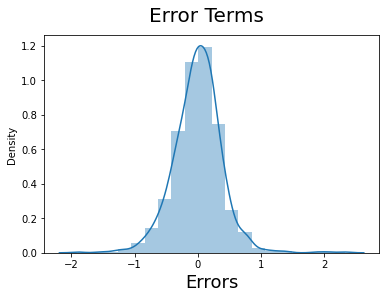

In [777]:
# Plot the histogram of the error terms
fig = plt.figure()
sns.distplot((y_train_rfe - y_train_rfe_cnt), bins = 20)
fig.suptitle('Error Terms', fontsize = 20)                  # Plot heading 
plt.xlabel('Errors', fontsize = 18)                         # X-label

### Making Predictions on the Test Set using the trained model

Use the model to Predict the target variable for the Test Data

In [778]:
sel_cols

['LotFrontage',
 'LotArea',
 'YearBuilt',
 'YearRemodAdd',
 'MasVnrArea',
 'BsmtFinSF1',
 'BsmtUnfSF',
 'TotalBsmtSF',
 '1stFlrSF',
 '2ndFlrSF',
 'GrLivArea',
 'BsmtFullBath',
 'BsmtHalfBath',
 'FullBath',
 'HalfBath',
 'KitchenAbvGr',
 'GarageYrBlt',
 'GarageArea',
 'WoodDeckSF',
 'OpenPorchSF',
 'SalePrice']

In [779]:
# Apply scaler() to all the columns except the 'yes-no' and 'dummy' variables

house_test_df[sel_cols] = rfescaler.fit_transform(house_test_df[sel_cols])

In [780]:
house_test_df.describe()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,KitchenAbvGr,GarageYrBlt,GarageArea,WoodDeckSF,OpenPorchSF,SalePrice,Overall_Q2,Overall_Q3,Overall_Q4,Overall_Q5,Overall_Q6,Overall_Q7,Overall_Q8,Overall_Q9,Overall_Q10,Overall_Cond2,Overall_Cond3,Overall_Cond4,Overall_Cond5,Overall_Cond6,Overall_Cond7,Overall_Cond8,Overall_Cond9,BedroomAbvGr_1,BedroomAbvGr_2,BedroomAbvGr_3,BedroomAbvGr_4,BedroomAbvGr_5,BedroomAbvGr_6,TotRmsAbvGrd_3,TotRmsAbvGrd_4,TotRmsAbvGrd_5,TotRmsAbvGrd_6,TotRmsAbvGrd_7,TotRmsAbvGrd_8,TotRmsAbvGrd_9,TotRmsAbvGrd_10,TotRmsAbvGrd_11,TotRmsAbvGrd_12,MoSold_2,MoSold_3,MoSold_4,MoSold_5,MoSold_6,MoSold_7,MoSold_8,MoSold_9,MoSold_10,MoSold_11,MoSold_12,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,AsphShn,BrkComm,BrkFace,CBlock,CemntBd,HdBoard,ImStucc,MetalSd,Plywood,Stone,Stucco,VinylSd,Wd Sdng,WdShing,Exterior2nd_AsphShn,Exterior2nd_BrkCmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_WdSdng,Exterior2nd_WdShng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,KitchenQual_2fmCon,KitchenQual_Duplex,KitchenQual_Twnhs,Fireplaces_1,Fireplaces_2,Fireplaces_3,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageFinish_RFn,GarageFinish_Unf,GarageCars_1,GarageCars_2,GarageCars_3,GarageCars_4,YrSold_2007,YrSold_2008,YrSold_2009,YrSold_2010,MSSub_30,MSSub_40,MSSub_45,MSSub_50,MSSub_60,MSSub_70,MSSub_75,MSSub_80,MSSub_85,MSSub_90,MSSub_120,MSSub_160,MSSub_180,MSSub_190
count,4.070000e+02,4.070000e+02,4.070000e+02,4.070000e+02,4.070000e+02,4.070000e+02,4.070000e+02,4.070000e+02,4.070000e+02,4.070000e+02,4.070000e+02,4.070000e+02,4.070000e+02,4.070000e+02,4.070000e+02,4.070000e+02,4.070000e+02,4.070000e+02,4.070000e+02,4.070000e+02,4.070000e+02,407.0,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.0,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.000000,407.

In [781]:
y_test_rfe = house_test_df.pop('SalePrice')
X_test_rfe = house_test_df

In [789]:
X_train_rfe_con.columns

Index(['1stFlrSF', '2ndFlrSF', 'Overall_Q7', 'Overall_Q8', 'Overall_Q9',
       'Overall_Q10', 'Overall_Cond4', 'Overall_Cond6', 'Overall_Cond7',
       'Overall_Cond8', 'Overall_Cond9', 'TotRmsAbvGrd_11',
       'Neighborhood_Crawfor', 'Neighborhood_MeadowV', 'Neighborhood_NoRidge',
       'Neighborhood_NridgHt', 'Neighborhood_StoneBr', 'Exterior2nd_CmentBd',
       'BsmtQual_Fa', 'BsmtQual_Gd', 'BsmtQual_TA', 'BsmtExposure_Gd',
       'MSSub_90', 'MSSub_120', 'MSSub_160', 'MSSub_180', 'MSSub_190'],
      dtype='object')

In [794]:
 X_test_rfe_con = X_test_rfe[X_train_rfe_con.columns]

In [795]:
# Adding constant variable to test dataframe
X_test_rfe_lm_1 = sm.add_constant(X_test_rfe_con)

In [796]:
X_test_rfe_lm_1.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 407 entries, 280 to 1377
Data columns (total 28 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   const                 407 non-null    float64
 1   1stFlrSF              407 non-null    float64
 2   2ndFlrSF              407 non-null    float64
 3   Overall_Q7            407 non-null    uint8  
 4   Overall_Q8            407 non-null    uint8  
 5   Overall_Q9            407 non-null    uint8  
 6   Overall_Q10           407 non-null    uint8  
 7   Overall_Cond4         407 non-null    uint8  
 8   Overall_Cond6         407 non-null    uint8  
 9   Overall_Cond7         407 non-null    uint8  
 10  Overall_Cond8         407 non-null    uint8  
 11  Overall_Cond9         407 non-null    uint8  
 12  TotRmsAbvGrd_11       407 non-null    uint8  
 13  Neighborhood_Crawfor  407 non-null    uint8  
 14  Neighborhood_MeadowV  407 non-null    uint8  
 15  Neighborhood_NoRidge

In [797]:
# Making predictions using the Final model

y_pred_rfe_m1 = lr_rfe_4.predict(X_test_rfe_lm_1)

In [799]:
y_pred_rfe_m1.shape

(407,)

In [800]:
y_test_rfe.shape

(407,)

### Model Evaluation

Text(0, 0.5, 'y_pred')

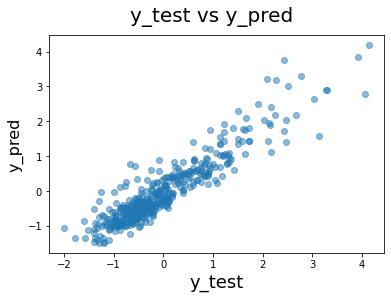

In [801]:
fig = plt.figure()
plt.scatter(y_test_rfe, y_pred_rfe_m1, alpha=.5)
fig.suptitle('y_test vs y_pred', fontsize = 20)              # Plot heading 
plt.xlabel('y_test', fontsize = 18)                          # X-label
plt.ylabel('y_pred', fontsize = 16)  

### R2 Score from the Test Set

In [802]:
from sklearn.metrics import r2_score
r2_score(y_test_rfe, y_pred_rfe_m1)

0.8554016791299901

# Training Model R2 Score : 0.853

# Testing Model R2 Score: 0.855

### Checking The Assumptions

In [803]:
#Residual Analysis
y_residuals =  y_test_rfe - y_pred_rfe_m1

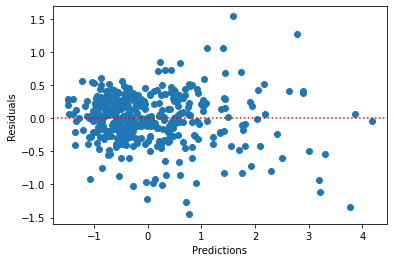

In [808]:
# Residual v/s predictions plot
#data['res'] = y_residuals
plt.scatter( y_pred_rfe_m1 , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("Predictions")
plt.ylabel("Residuals")
plt.show()

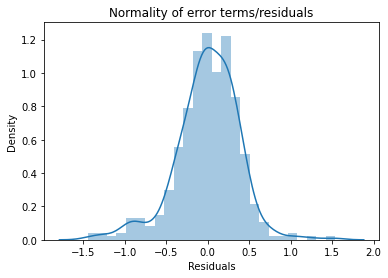

In [806]:
# Distribution of errors
p = sns.distplot(y_residuals,kde=True)

p = plt.title('Normality of error terms/residuals')
plt.xlabel("Residuals")
plt.show()

### Identify if any pattern in the normality of error terms / Residual Analysis

In [818]:
X_test_rfe_lm_1.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 407 entries, 280 to 1377
Data columns (total 28 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   const                 407 non-null    float64
 1   1stFlrSF              407 non-null    float64
 2   2ndFlrSF              407 non-null    float64
 3   Overall_Q7            407 non-null    uint8  
 4   Overall_Q8            407 non-null    uint8  
 5   Overall_Q9            407 non-null    uint8  
 6   Overall_Q10           407 non-null    uint8  
 7   Overall_Cond4         407 non-null    uint8  
 8   Overall_Cond6         407 non-null    uint8  
 9   Overall_Cond7         407 non-null    uint8  
 10  Overall_Cond8         407 non-null    uint8  
 11  Overall_Cond9         407 non-null    uint8  
 12  TotRmsAbvGrd_11       407 non-null    uint8  
 13  Neighborhood_Crawfor  407 non-null    uint8  
 14  Neighborhood_MeadowV  407 non-null    uint8  
 15  Neighborhood_NoRidge

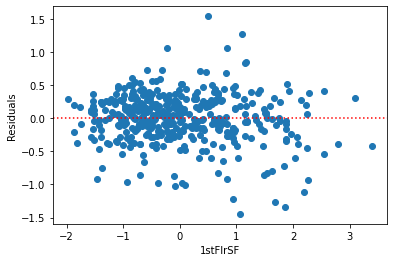

In [819]:
# Residual v/s predictions plot
#data['res'] = y_residuals
plt.scatter( X_test_rfe["1stFlrSF"] , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("1stFlrSF")
plt.ylabel("Residuals")
plt.show()

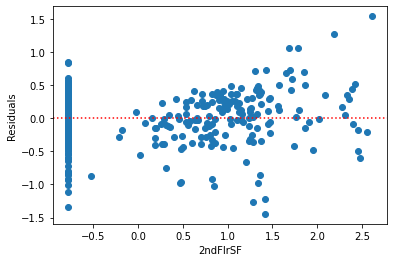

In [820]:
plt.scatter( X_test_rfe["2ndFlrSF"] , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("2ndFlrSF")
plt.ylabel("Residuals")
plt.show()

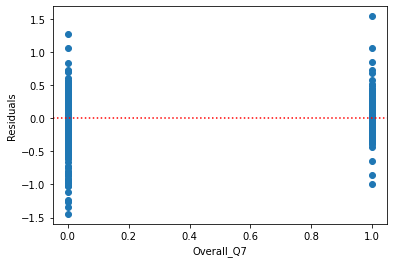

In [821]:

plt.scatter( X_test_rfe["Overall_Q7"] , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("Overall_Q7")
plt.ylabel("Residuals")
plt.show()

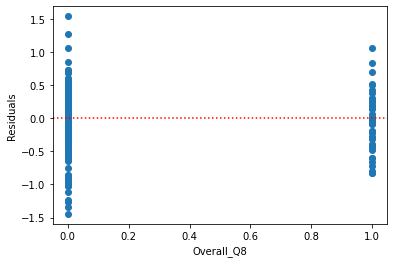

In [822]:

plt.scatter( X_test_rfe["Overall_Q8"] , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("Overall_Q8")
plt.ylabel("Residuals")
plt.show()

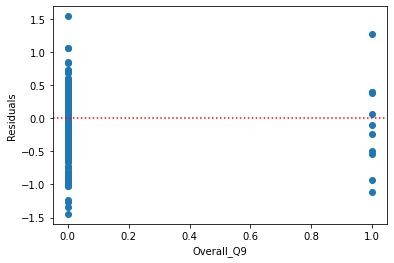

In [823]:

plt.scatter( X_test_rfe["Overall_Q9"] , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("Overall_Q9")
plt.ylabel("Residuals")
plt.show()

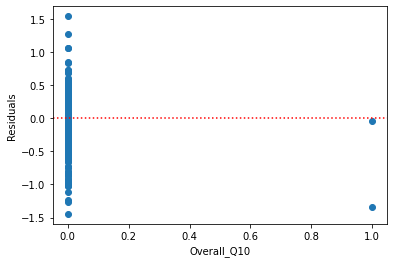

In [824]:

plt.scatter( X_test_rfe["Overall_Q10"] , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("Overall_Q10")
plt.ylabel("Residuals")
plt.show()

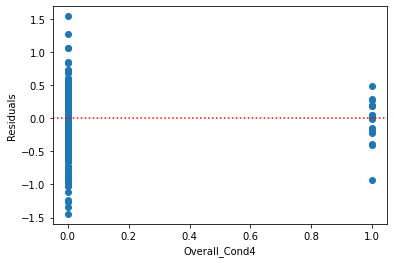

In [825]:

plt.scatter( X_test_rfe["Overall_Cond4"] , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("Overall_Cond4")
plt.ylabel("Residuals")
plt.show()

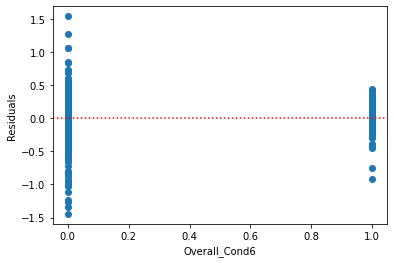

In [826]:

plt.scatter( X_test_rfe["Overall_Cond6"] , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("Overall_Cond6")
plt.ylabel("Residuals")
plt.show()

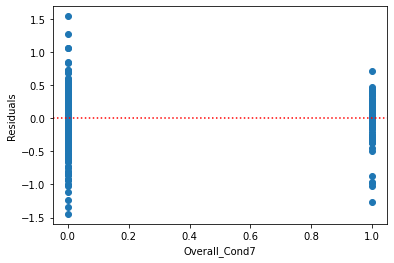

In [827]:

plt.scatter( X_test_rfe["Overall_Cond7"] , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("Overall_Cond7")
plt.ylabel("Residuals")
plt.show()

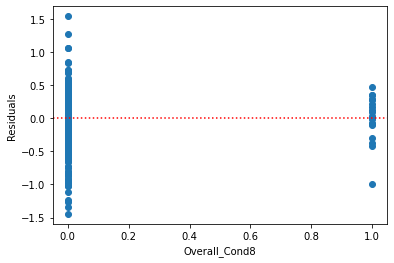

In [828]:

plt.scatter( X_test_rfe["Overall_Cond8"] , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("Overall_Cond8")
plt.ylabel("Residuals")
plt.show()

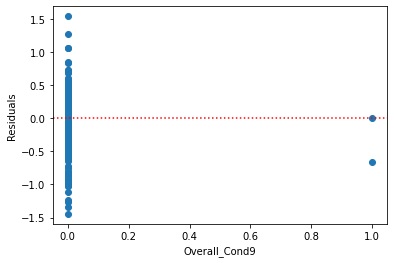

In [829]:

plt.scatter( X_test_rfe["Overall_Cond9"] , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("Overall_Cond9")
plt.ylabel("Residuals")
plt.show()

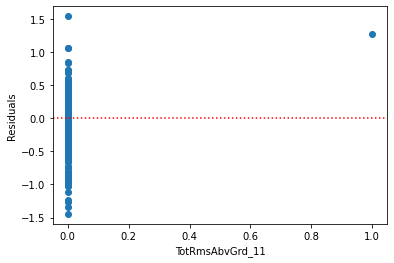

In [830]:

plt.scatter( X_test_rfe["TotRmsAbvGrd_11"] , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("TotRmsAbvGrd_11")
plt.ylabel("Residuals")
plt.show()

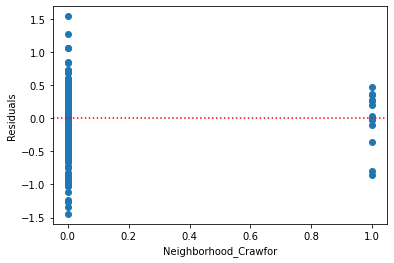

In [831]:

plt.scatter( X_test_rfe["Neighborhood_Crawfor"] , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("Neighborhood_Crawfor")
plt.ylabel("Residuals")
plt.show()

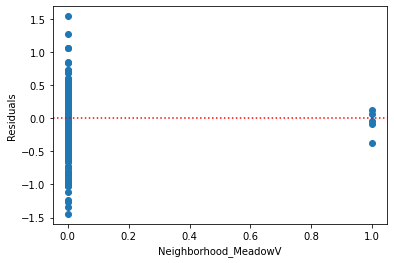

In [832]:

plt.scatter( X_test_rfe["Neighborhood_MeadowV"] , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("Neighborhood_MeadowV")
plt.ylabel("Residuals")
plt.show()

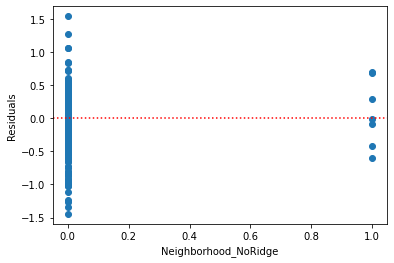

In [833]:

plt.scatter( X_test_rfe["Neighborhood_NoRidge"] , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("Neighborhood_NoRidge")
plt.ylabel("Residuals")
plt.show()

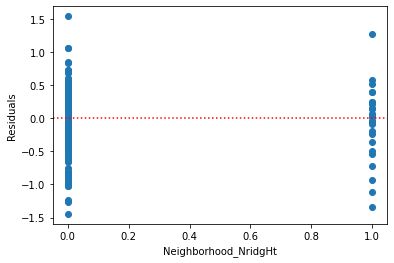

In [834]:

plt.scatter( X_test_rfe["Neighborhood_NridgHt"] , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("Neighborhood_NridgHt")
plt.ylabel("Residuals")
plt.show()

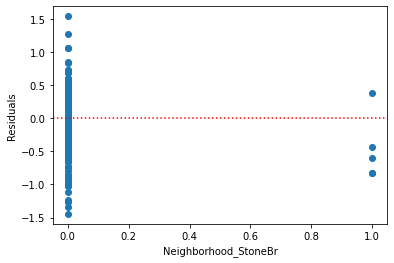

In [835]:

plt.scatter( X_test_rfe["Neighborhood_StoneBr"] , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("Neighborhood_StoneBr")
plt.ylabel("Residuals")
plt.show()

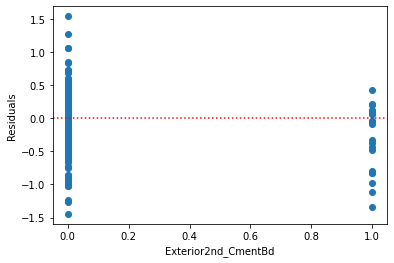

In [836]:

plt.scatter( X_test_rfe["Exterior2nd_CmentBd"] , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("Exterior2nd_CmentBd")
plt.ylabel("Residuals")
plt.show()

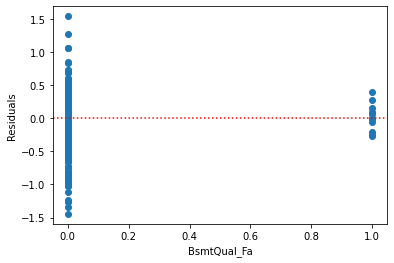

In [837]:

plt.scatter( X_test_rfe["BsmtQual_Fa"] , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("BsmtQual_Fa")
plt.ylabel("Residuals")
plt.show()

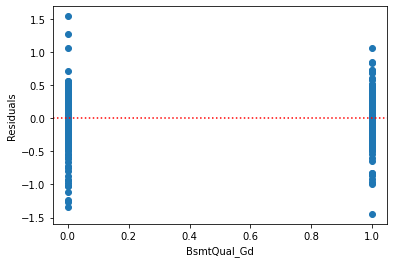

In [838]:

plt.scatter( X_test_rfe["BsmtQual_Gd"] , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("BsmtQual_Gd")
plt.ylabel("Residuals")
plt.show()

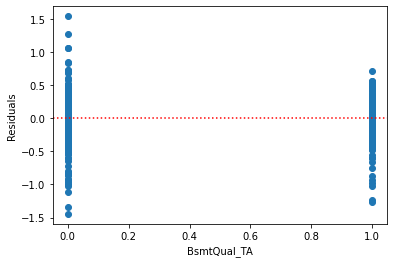

In [839]:

plt.scatter( X_test_rfe["BsmtQual_TA"] , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("BsmtQual_TA")
plt.ylabel("Residuals")
plt.show()

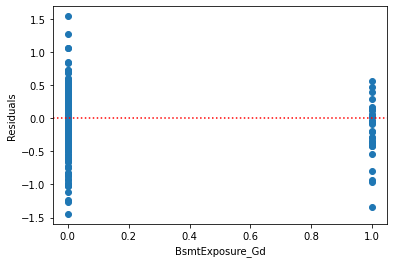

In [840]:

plt.scatter( X_test_rfe["BsmtExposure_Gd"] , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("BsmtExposure_Gd")
plt.ylabel("Residuals")
plt.show()

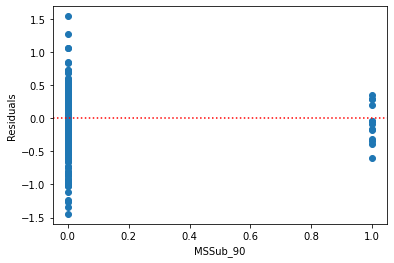

In [841]:

plt.scatter( X_test_rfe["MSSub_90"] , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("MSSub_90")
plt.ylabel("Residuals")
plt.show()

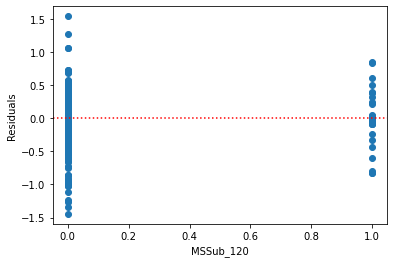

In [842]:

plt.scatter( X_test_rfe["MSSub_120"] , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("MSSub_120")
plt.ylabel("Residuals")
plt.show()

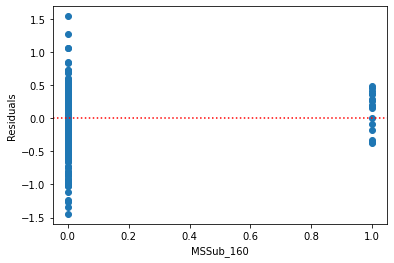

In [843]:

plt.scatter( X_test_rfe["MSSub_160"] , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("MSSub_160")
plt.ylabel("Residuals")
plt.show()

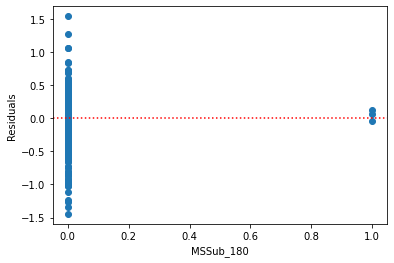

In [844]:

plt.scatter( X_test_rfe["MSSub_180"] , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("MSSub_180")
plt.ylabel("Residuals")
plt.show()

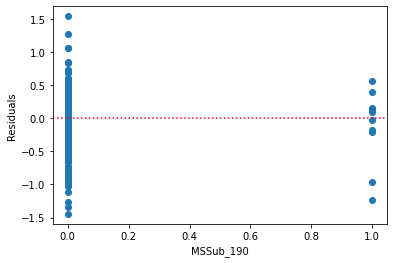

In [845]:

plt.scatter( X_test_rfe["MSSub_190"] , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("MSSub_190")
plt.ylabel("Residuals")
plt.show()

### <font color = "red"> There are no specific pattern present in any of the variables  </font>

## <font color=red> 4.2 Multiple Linear Regression Model using Data Transformation </font>

#### Apply Data Transformation to "1stFlrSF"

In [868]:
# Back up of X_train dataset before removing each variable
X_train_rfe_con_5 = X_train_rfe_con
X_train_rfe_con['1stFlrSF_exp'] = np.exp(X_train_rfe_con['1stFlrSF'])
X_train_rfe_con.columns

Index(['1stFlrSF', '2ndFlrSF', 'Overall_Q7', 'Overall_Q8', 'Overall_Q9',
       'Overall_Q10', 'Overall_Cond4', 'Overall_Cond6', 'Overall_Cond7',
       'Overall_Cond8', 'Overall_Cond9', 'TotRmsAbvGrd_11',
       'Neighborhood_Crawfor', 'Neighborhood_MeadowV', 'Neighborhood_NoRidge',
       'Neighborhood_NridgHt', 'Neighborhood_StoneBr', 'Exterior2nd_CmentBd',
       'BsmtQual_Fa', 'BsmtQual_Gd', 'BsmtQual_TA', 'BsmtExposure_Gd',
       'MSSub_90', 'MSSub_120', 'MSSub_160', 'MSSub_180', 'MSSub_190',
       '1stFlrSF_log', '1stFlrSF_temp', '1stFlrSF_exp'],
      dtype='object')

In [870]:
X_train_rfe_con = X_train_rfe_con.drop(columns=["1stFlrSF_log","1stFlrSF_temp"])

In [871]:
X_train_rfe_con.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 948 entries, 430 to 850
Data columns (total 28 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   1stFlrSF              948 non-null    float64
 1   2ndFlrSF              948 non-null    float64
 2   Overall_Q7            948 non-null    uint8  
 3   Overall_Q8            948 non-null    uint8  
 4   Overall_Q9            948 non-null    uint8  
 5   Overall_Q10           948 non-null    uint8  
 6   Overall_Cond4         948 non-null    uint8  
 7   Overall_Cond6         948 non-null    uint8  
 8   Overall_Cond7         948 non-null    uint8  
 9   Overall_Cond8         948 non-null    uint8  
 10  Overall_Cond9         948 non-null    uint8  
 11  TotRmsAbvGrd_11       948 non-null    uint8  
 12  Neighborhood_Crawfor  948 non-null    uint8  
 13  Neighborhood_MeadowV  948 non-null    uint8  
 14  Neighborhood_NoRidge  948 non-null    uint8  
 15  Neighborhood_NridgHt 

In [872]:
# Build a 5th fitted model
X_train_rfe_lm_5 = sm.add_constant(X_train_rfe_con)
lr_rfe_5 = sm.OLS(y_train_rfe, X_train_rfe_lm_5).fit()
print(lr_rfe_5.summary())

                            OLS Regression Results                            
Dep. Variable:              SalePrice   R-squared:                       0.853
Model:                            OLS   Adj. R-squared:                  0.848
Method:                 Least Squares   F-statistic:                     190.3
Date:                Tue, 31 Jan 2023   Prob (F-statistic):               0.00
Time:                        23:00:15   Log-Likelihood:                -436.71
No. Observations:                 948   AIC:                             931.4
Df Residuals:                     919   BIC:                             1072.
Df Model:                          28                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.3101 

# Test with the Model that has the Data Transformation

In [874]:
X_test_rfe_con_1 = X_test_rfe_con
X_test_rfe_con['1stFlrSF_exp'] = np.exp(X_test_rfe_con['1stFlrSF'])

In [875]:
# Adding constant variable to test dataframe
X_test_rfe_lm_2 = sm.add_constant(X_test_rfe_con)

In [876]:
y_pred_rfe_m2 = lr_rfe_5.predict(X_test_rfe_lm_2)

### R2 Score from the Data Transformed Test Set

In [877]:
from sklearn.metrics import r2_score
r2_score(y_test_rfe, y_pred_rfe_m2)

0.8555204862493622

### Checking The Assumptions

In [803]:
#Residual Analysis
y_residuals =  y_test_rfe - y_pred_rfe_m2

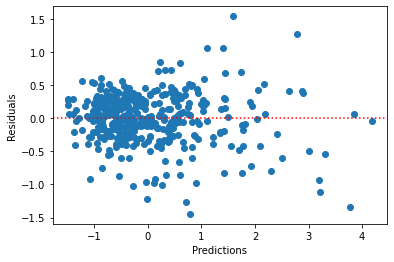

In [878]:
# Residual v/s predictions plot
#data['res'] = y_residuals
plt.scatter( y_pred_rfe_m2 , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("Predictions")
plt.ylabel("Residuals")
plt.show()

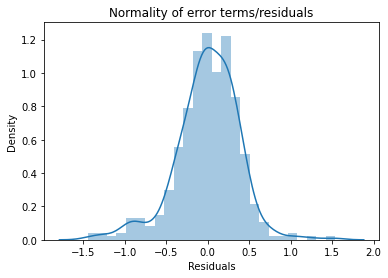

In [879]:
# Distribution of errors
p = sns.distplot(y_residuals,kde=True)

p = plt.title('Normality of error terms/residuals')
plt.xlabel("Residuals")
plt.show()

## <font color=red> 4.3 Creating Model Using Ridge Regression </font>

In [884]:
X_train_rfe_con.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 948 entries, 430 to 850
Data columns (total 27 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   1stFlrSF              948 non-null    float64
 1   2ndFlrSF              948 non-null    float64
 2   Overall_Q7            948 non-null    uint8  
 3   Overall_Q8            948 non-null    uint8  
 4   Overall_Q9            948 non-null    uint8  
 5   Overall_Q10           948 non-null    uint8  
 6   Overall_Cond4         948 non-null    uint8  
 7   Overall_Cond6         948 non-null    uint8  
 8   Overall_Cond7         948 non-null    uint8  
 9   Overall_Cond8         948 non-null    uint8  
 10  Overall_Cond9         948 non-null    uint8  
 11  TotRmsAbvGrd_11       948 non-null    uint8  
 12  Neighborhood_Crawfor  948 non-null    uint8  
 13  Neighborhood_MeadowV  948 non-null    uint8  
 14  Neighborhood_NoRidge  948 non-null    uint8  
 15  Neighborhood_NridgHt 

In [885]:
y_train_rfe.info()

<class 'pandas.core.series.Series'>
Int64Index: 948 entries, 430 to 850
Series name: SalePrice
Non-Null Count  Dtype  
--------------  -----  
948 non-null    float64
dtypes: float64(1)
memory usage: 14.8 KB


In [887]:
# Lamda values to penalize the cost function.

alpha_params = {'alpha': [0.00001, 0.0001, 0.001, 0.01, 0.05, 0.1, 
 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0, 
 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20.0, 30.0, 40.0, 50.0, 100.0, 500.0, 1000.0 ]}

#Instantiate Ridge Regression
ridgeRegression = Ridge()

# Use 5 fold cross validation
folds = 5
X_train_rfe_lm_6 = GridSearchCV(estimator = ridgeRegression, 
                        param_grid = alpha_params, 
                        scoring= 'neg_mean_absolute_error',  
                        cv = folds, 
                        return_train_score=True,
                        verbose = 1)            
X_train_rfe_lm_6.fit(X_train_rfe_con, y_train_rfe)

Fitting 5 folds for each of 31 candidates, totalling 155 fits


GridSearchCV(cv=5, estimator=Ridge(),
             param_grid={'alpha': [1e-05, 0.0001, 0.001, 0.01, 0.05, 0.1, 0.2,
                                   0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0,
                                   3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0,
                                   20.0, 30.0, 40.0, 50.0, 100.0, 500.0, ...]},
             return_train_score=True, scoring='neg_mean_absolute_error',
             verbose=1)

In [888]:
# Printing the best hyperparameter alpha
print(X_train_rfe_lm_6.best_params_)

{'alpha': 0.6}


In [890]:
#Fitting Ridge model for the best lambda parameter 0.6
alpha = 0.6
ridgeRegression_best = Ridge(alpha=alpha)

ridgeRegression_best.fit(X_train_rfe_con, y_train_rfe)
print(ridgeRegression_best.coef_)

[ 0.40094602  0.29828599  0.30372246  0.67718345  1.31481392  1.36058633
 -0.24955766  0.08845657  0.14957982  0.21630419  0.26153586 -0.38316334
  0.2722202  -0.52728809  0.36089322  0.45504049  0.53102408  0.44776586
 -1.05707069 -0.36771016 -0.79849285  0.40541558 -0.42761855 -0.24812204
 -0.24604937 -0.46817312 -0.30637067]


In [891]:
X_test_rfe_con.columns

Index(['1stFlrSF', '2ndFlrSF', 'Overall_Q7', 'Overall_Q8', 'Overall_Q9',
       'Overall_Q10', 'Overall_Cond4', 'Overall_Cond6', 'Overall_Cond7',
       'Overall_Cond8', 'Overall_Cond9', 'TotRmsAbvGrd_11',
       'Neighborhood_Crawfor', 'Neighborhood_MeadowV', 'Neighborhood_NoRidge',
       'Neighborhood_NridgHt', 'Neighborhood_StoneBr', 'Exterior2nd_CmentBd',
       'BsmtQual_Fa', 'BsmtQual_Gd', 'BsmtQual_TA', 'BsmtExposure_Gd',
       'MSSub_90', 'MSSub_120', 'MSSub_160', 'MSSub_180', 'MSSub_190',
       '1stFlrSF_exp'],
      dtype='object')

In [898]:
y_pred_ridge_m3 = ridgeRegression_best.predict(X_test_rfe_con)

### R2 Score from the Ridge Model Test Set

In [894]:
from sklearn.metrics import r2_score
r2_score(y_test_rfe, y_pred_ridge_m3)

0.8577086120981334

### Checking The Assumptions

In [895]:
#Residual Analysis
y_residuals =  y_test_rfe - y_pred_ridge_m3

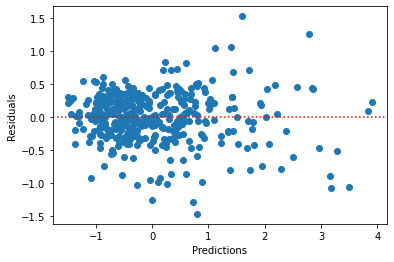

In [896]:
# Residual v/s predictions plot
#data['res'] = y_residuals
plt.scatter( y_pred_ridge_m3 , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("Predictions")
plt.ylabel("Residuals")
plt.show()

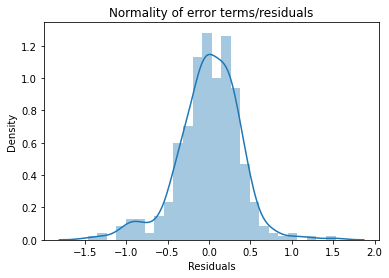

In [897]:
# Distribution of errors
p = sns.distplot(y_residuals,kde=True)

p = plt.title('Normality of error terms/residuals')
plt.xlabel("Residuals")
plt.show()

##  <font color=red> 4.4 Creating Model Using Lasso Regression </font>

In [900]:
X_train_rfe_con.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 948 entries, 430 to 850
Data columns (total 27 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   1stFlrSF              948 non-null    float64
 1   2ndFlrSF              948 non-null    float64
 2   Overall_Q7            948 non-null    uint8  
 3   Overall_Q8            948 non-null    uint8  
 4   Overall_Q9            948 non-null    uint8  
 5   Overall_Q10           948 non-null    uint8  
 6   Overall_Cond4         948 non-null    uint8  
 7   Overall_Cond6         948 non-null    uint8  
 8   Overall_Cond7         948 non-null    uint8  
 9   Overall_Cond8         948 non-null    uint8  
 10  Overall_Cond9         948 non-null    uint8  
 11  TotRmsAbvGrd_11       948 non-null    uint8  
 12  Neighborhood_Crawfor  948 non-null    uint8  
 13  Neighborhood_MeadowV  948 non-null    uint8  
 14  Neighborhood_NoRidge  948 non-null    uint8  
 15  Neighborhood_NridgHt 

In [901]:
y_train_rfe.info()

<class 'pandas.core.series.Series'>
Int64Index: 948 entries, 430 to 850
Series name: SalePrice
Non-Null Count  Dtype  
--------------  -----  
948 non-null    float64
dtypes: float64(1)
memory usage: 14.8 KB


In [902]:
# Lamda values to penalize the cost function.

alpha_params = {'alpha': [0.00001, 0.0001, 0.001, 0.01, 0.05, 0.1, 
 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0, 
 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20.0, 30.0, 40.0, 50.0, 100.0, 500.0, 1000.0 ]}

#Instantiate Lasso Regression
lassoRegression = Lasso()

# Use 5 fold cross validation
folds = 5
X_train_rfe_lm_7 = GridSearchCV(estimator = lassoRegression, 
                        param_grid = alpha_params, 
                        scoring= 'neg_mean_absolute_error',  
                        cv = folds, 
                        return_train_score=True,
                        verbose = 1)            
X_train_rfe_lm_7.fit(X_train_rfe_con, y_train_rfe)

Fitting 5 folds for each of 31 candidates, totalling 155 fits


GridSearchCV(cv=5, estimator=Lasso(),
             param_grid={'alpha': [1e-05, 0.0001, 0.001, 0.01, 0.05, 0.1, 0.2,
                                   0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0,
                                   3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0,
                                   20.0, 30.0, 40.0, 50.0, 100.0, 500.0, ...]},
             return_train_score=True, scoring='neg_mean_absolute_error',
             verbose=1)

In [903]:
# Printing the best hyperparameter alpha
print(X_train_rfe_lm_7.best_params_)

{'alpha': 0.001}


In [906]:
#Fitting Lasso model for the best lambda parameter 0.6
alpha = 0.001
lassoRegression_best = Lasso(alpha=alpha)

lassoRegression_best.fit(X_train_rfe_con, y_train_rfe)
print(lassoRegression_best.coef_)

[ 0.40659676  0.29949499  0.30521631  0.69478879  1.33905378  1.37792808
 -0.24931315  0.07244455  0.13537246  0.19009726  0.21289252 -0.27265012
  0.25282273 -0.44593551  0.31109109  0.42313219  0.46370193  0.3797635
 -1.00182231 -0.34028633 -0.76260148  0.38754596 -0.41306648 -0.21965112
 -0.22160009 -0.36022171 -0.26147271]


In [907]:
X_test_rfe_con.columns

Index(['1stFlrSF', '2ndFlrSF', 'Overall_Q7', 'Overall_Q8', 'Overall_Q9',
       'Overall_Q10', 'Overall_Cond4', 'Overall_Cond6', 'Overall_Cond7',
       'Overall_Cond8', 'Overall_Cond9', 'TotRmsAbvGrd_11',
       'Neighborhood_Crawfor', 'Neighborhood_MeadowV', 'Neighborhood_NoRidge',
       'Neighborhood_NridgHt', 'Neighborhood_StoneBr', 'Exterior2nd_CmentBd',
       'BsmtQual_Fa', 'BsmtQual_Gd', 'BsmtQual_TA', 'BsmtExposure_Gd',
       'MSSub_90', 'MSSub_120', 'MSSub_160', 'MSSub_180', 'MSSub_190'],
      dtype='object')

In [908]:
y_pred_lasso_m4 = lassoRegression_best.predict(X_test_rfe_con)

### R2 Score from the Ridge Model Test Set

In [909]:
from sklearn.metrics import r2_score
r2_score(y_test_rfe, y_pred_lasso_m4)

0.8605125412345959

### Checking The Assumptions

In [910]:
#Residual Analysis
y_residuals =  y_test_rfe - y_pred_lasso_m4

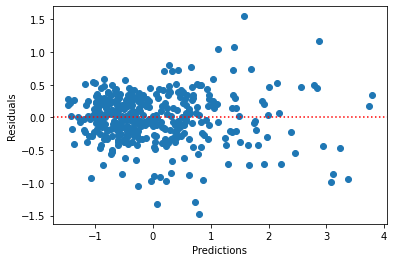

In [911]:
# Residual v/s predictions plot
#data['res'] = y_residuals
plt.scatter( y_pred_lasso_m4 , y_residuals)
plt.axhline(y=0, color='r', linestyle=':')
plt.xlabel("Predictions")
plt.ylabel("Residuals")
plt.show()

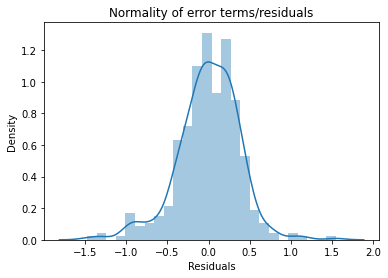

In [912]:
# Distribution of errors
p = sns.distplot(y_residuals,kde=True)

p = plt.title('Normality of error terms/residuals')
plt.xlabel("Residuals")
plt.show()

# 5. Summary

## <span style="background-color:blue"> <font color="white"> &nbsp; Linear Regression Training R2 Score : 0.853 &nbsp;</font></span>
    
## <span style="background-color:orange"> <font color="white"> &nbsp; Linear Regression Test R2 Score: 0.8554016791299901 &nbsp; </font></span>

## <span style="background-color:orange"> <font color="white"> &nbsp; Data Transfromed LR  Test R2 Score: 0.8555204862493622 &nbsp; </font></span>

## <span style="background-color:orange"> <font color="white"> &nbsp; Ridge Regression Test R2 Score: 0.8577086120981334 &nbsp; </font></span>

## <span style="background-color:green"> <font color="white"> &nbsp; Lasso Regression Test R2 Score: 0.8605125412345959 &nbsp; </font></span>

# ------------------------------------------------------------------------

# Part II - Subjective Questions

### Question 1: What is the optimal value of alpha for ridge and lasso regression? What will be the changes in the model if you choose double the value of alpha for both ridge and lasso? What will be the most important predictor variables after the change is implemented?

#### 1.1.  The optimal alpha value for Ridge is "0.6"
#### 1.2. The optimal alpha value for Lasso is "0.001"
#### 1.3.1. Let's double the value of alpha and check Ridge

In [913]:
#Fitting Ridge model for the best lambda parameter 0.12
alpha = 0.12
ridgeRegression_best = Ridge(alpha=alpha)

ridgeRegression_best.fit(X_train_rfe_con, y_train_rfe)
print(ridgeRegression_best.coef_)

[ 0.39570586  0.295576    0.31028958  0.68865281  1.36243861  1.58823657
 -0.24345003  0.09378364  0.15464616  0.22400766  0.26859141 -0.41520705
  0.27930523 -0.54960158  0.37156095  0.44122776  0.54322431  0.45550968
 -1.08229793 -0.36885768 -0.80089046  0.40989235 -0.42763153 -0.25268677
 -0.24931348 -0.49811432 -0.31212666]


In [914]:
y_pred_ridge_m4 = ridgeRegression_best.predict(X_test_rfe_con)

In [915]:
r2_score(y_test_rfe, y_pred_ridge_m4)

0.8559975167021554

#### <font color=red> For Ridge Coeff's are increased but R2 score decreased </font>

#### 1.3.2. Let's double the value of alpha and check Lasso

In [916]:
#Fitting Lasso model for the best lambda parameter 0.002
alpha = 0.002
lassoRegression_best = Lasso(alpha=alpha)

lassoRegression_best.fit(X_train_rfe_con, y_train_rfe)
print(lassoRegression_best.coef_)

[ 0.41890471  0.30416796  0.29819051  0.69737826  1.30181066  1.09740536
 -0.25689498  0.0496838   0.11473931  0.15416031  0.15535571 -0.12155423
  0.2244663  -0.33700191  0.24798162  0.40925744  0.38124986  0.30253451
 -0.91579794 -0.31226143 -0.72463474  0.36397842 -0.39864209 -0.18559192
 -0.19308745 -0.21424909 -0.20939126]


In [919]:
y_pred_lasso_m5 = lassoRegression_best.predict(X_test_rfe_con)

In [920]:
r2_score(y_test_rfe, y_pred_lasso_m5)

0.8619816621939008

#### <font color=red> For Lasso Coeff's are increased and R2 score increased </font>

#### 1.4. Most important predictor variables after the change

In [921]:
house_prc_pred = pd.DataFrame(index=X_train_rfe_con.columns)

In [922]:
house_prc_pred.rows = X_train_rfe_con.columns

In [924]:
house_prc_pred["Ridge"] = ridgeRegression_best.coef_
house_prc_pred["Lasso"] = lassoRegression_best.coef_

In [925]:
pd.set_option('display.max_rows', None)

In [934]:
np.abs(house_prc_pred["Ridge"]).sort_values(ascending = False)

Overall_Q10             1.588237
Overall_Q9              1.362439
BsmtQual_Fa             1.082298
BsmtQual_TA             0.800890
Overall_Q8              0.688653
Neighborhood_MeadowV    0.549602
Neighborhood_StoneBr    0.543224
MSSub_180               0.498114
Exterior2nd_CmentBd     0.455510
Neighborhood_NridgHt    0.441228
MSSub_90                0.427632
TotRmsAbvGrd_11         0.415207
BsmtExposure_Gd         0.409892
1stFlrSF                0.395706
Neighborhood_NoRidge    0.371561
BsmtQual_Gd             0.368858
MSSub_190               0.312127
Overall_Q7              0.310290
2ndFlrSF                0.295576
Neighborhood_Crawfor    0.279305
Overall_Cond9           0.268591
MSSub_120               0.252687
MSSub_160               0.249313
Overall_Cond4           0.243450
Overall_Cond8           0.224008
Overall_Cond7           0.154646
Overall_Cond6           0.093784
Name: Ridge, dtype: float64

In [949]:
np.abs(house_prc_pred["Lasso"]).sort_values(ascending = False).head()

Overall_Q9     1.301811
Overall_Q10    1.097405
BsmtQual_Fa    0.915798
BsmtQual_TA    0.724635
Overall_Q8     0.697378
Name: Lasso, dtype: float64

#### Top 5 Features  <font color=red> Overall_Q10, Overall_Q9, BsmtQual_Fa, BsmtQual_TA, Overall_Q8 </font>

### Question 2: You have determined the optimal value of lambda for ridge and lasso regression during the assignment. Now, which one will you choose to apply and why?

For this House Pricing Data Set,  I would choose Lasso over ridge, as Lasso performance is better and also has the ability to drop off the features when it's not needed. I would apply Lasso for further prediction of hosuse prices.

### Question 3: After building the model, you realised that the five most important predictor variables in the lasso model are not available in the incoming data. You will now have to create another model excluding the five most important predictor variables. Which are the five most important predictor variables now?

In [936]:
X_train_rfe_con_15 = X_train_rfe_con
X_test_rfe_con_15 = X_test_rfe_con

X_train_rfe_con = X_train_rfe_con.drop(['Overall_Q10', 'Overall_Q9', 'BsmtQual_Fa',
                                        'BsmtQual_TA', 'Overall_Q8'], axis=1)
X_test_rfe_con = X_test_rfe_con.drop(['Overall_Q10', 'Overall_Q9', 'BsmtQual_Fa',
                                      'BsmtQual_TA', 'Overall_Q8'], axis=1)

In [937]:
# Lamda values to penalize the cost function.

alpha_params = {'alpha': [0.00001, 0.0001, 0.001, 0.01, 0.05, 0.1, 
 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0, 
 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20.0, 30.0, 40.0, 50.0, 100.0, 500.0, 1000.0 ]}

#Instantiate Lasso Regression
lassoRegression = Lasso()

# Use 5 fold cross validation
folds = 5
X_train_rfe_lm_8 = GridSearchCV(estimator = lassoRegression, 
                        param_grid = alpha_params, 
                        scoring= 'neg_mean_absolute_error',  
                        cv = folds, 
                        return_train_score=True,
                        verbose = 1)            
X_train_rfe_lm_8.fit(X_train_rfe_con, y_train_rfe)

Fitting 5 folds for each of 31 candidates, totalling 155 fits


GridSearchCV(cv=5, estimator=Lasso(),
             param_grid={'alpha': [1e-05, 0.0001, 0.001, 0.01, 0.05, 0.1, 0.2,
                                   0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0,
                                   3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0,
                                   20.0, 30.0, 40.0, 50.0, 100.0, 500.0, ...]},
             return_train_score=True, scoring='neg_mean_absolute_error',
             verbose=1)

In [938]:
print(X_train_rfe_lm_8.best_params_)

{'alpha': 0.001}


In [939]:
#Fitting Lasso model for the best lambda parameter 0.002
alpha = 0.001
lassoRegression_best = Lasso(alpha=alpha)

lassoRegression_best.fit(X_train_rfe_con, y_train_rfe)
print(lassoRegression_best.coef_)

[ 0.55787178  0.39768604  0.07084261 -0.49118688 -0.10605121 -0.0389994
  0.          0.08034535 -0.15942239  0.21433446 -0.76592105  0.43555315
  1.23731853  0.91533011  0.80199295  0.28912288  0.56146024 -0.69300707
 -0.15831035 -0.25567405 -0.38359864 -0.37235253]


In [943]:
house_prc_pred_1 = pd.DataFrame(index=X_train_rfe_con.columns)

In [944]:
house_prc_pred_1.rows = X_train_rfe_con.columns

In [946]:
house_prc_pred_1["Lasso"] = lassoRegression_best.coef_

In [950]:
np.abs(house_prc_pred_1["Lasso"]).sort_values(ascending = False).head()

Neighborhood_NridgHt    1.237319
Neighborhood_StoneBr    0.915330
Exterior2nd_CmentBd     0.801993
Neighborhood_MeadowV    0.765921
MSSub_90                0.693007
Name: Lasso, dtype: float64

####  The Five most important predictors now are <font color=red> Neighborhood_NridgHt, Neighborhood_StoneBr, Exterior2nd_CmentBd, Neighborhood_MeadowV, MSSub_90 </font>


### Question 4: How can you make sure that a model is robust and generalisable? What are the implications of the same for the accuracy of the model and why?

1. Keep minimum number of features as possible to make the model more generalisable. More number of features will overfit the model and changes in the input would result in poor performance which in turn will need to change the features to fit the new data. 

2. Model will be more robust when Data is cleaned, imputated, outliers removed properly during  the model training.

3. Feature selection is very important process to increase the model accuracy, so need to make sure p-value is less than 0.05 and VIF is less than 5.

4. Testing the model with different set of data will improve the robustness as well, using techniques like Cross Validation would be of great advantage.